In [2]:
import torch
from torchvision.transforms import v2
import matplotlib.pyplot as plt
import numpy as np
import collections
import seaborn as sns
import math
import random
import gc
import pickle
from PIL import Image
import io

from dreamsim import dreamsim


import datasets.registry as datareg
from foundations import hparams
from platforms import platform as P
from platforms.local import Platform as LocalPlatform
from platforms.platform import get_platform

from threat_specification.projected_displacement import ProjectedDisplacement


from corruptions.ImageNetC.create_c import make_imagenet_c as make_imagenet_c
from corruptions.ImageNetC.imagenetc.imagenet_c import corrupt
from corruptions.ImageNetC.imagenetc.imagenet_c.corruptions import *
from corruptions.imagenet_c_bar.transform_finder import transform_dict as cbar_dict
from corruptions.imagenet_c_bar.transform_finder import (
    build_transform as corruption_cbar,
)

In [3]:
get_platform() == None
old_platform = None
P._PLATFORM = LocalPlatform()

In [4]:
imagenet_class_json = {
    "0": ["n01440764", "tench"],
    "1": ["n01443537", "goldfish"],
    "2": ["n01484850", "great_white_shark"],
    "3": ["n01491361", "tiger_shark"],
    "4": ["n01494475", "hammerhead"],
    "5": ["n01496331", "electric_ray"],
    "6": ["n01498041", "stingray"],
    "7": ["n01514668", "cock"],
    "8": ["n01514859", "hen"],
    "9": ["n01518878", "ostrich"],
    "10": ["n01530575", "brambling"],
    "11": ["n01531178", "goldfinch"],
    "12": ["n01532829", "house_finch"],
    "13": ["n01534433", "junco"],
    "14": ["n01537544", "indigo_bunting"],
    "15": ["n01558993", "robin"],
    "16": ["n01560419", "bulbul"],
    "17": ["n01580077", "jay"],
    "18": ["n01582220", "magpie"],
    "19": ["n01592084", "chickadee"],
    "20": ["n01601694", "water_ouzel"],
    "21": ["n01608432", "kite"],
    "22": ["n01614925", "bald_eagle"],
    "23": ["n01616318", "vulture"],
    "24": ["n01622779", "great_grey_owl"],
    "25": ["n01629819", "European_fire_salamander"],
    "26": ["n01630670", "common_newt"],
    "27": ["n01631663", "eft"],
    "28": ["n01632458", "spotted_salamander"],
    "29": ["n01632777", "axolotl"],
    "30": ["n01641577", "bullfrog"],
    "31": ["n01644373", "tree_frog"],
    "32": ["n01644900", "tailed_frog"],
    "33": ["n01664065", "loggerhead"],
    "34": ["n01665541", "leatherback_turtle"],
    "35": ["n01667114", "mud_turtle"],
    "36": ["n01667778", "terrapin"],
    "37": ["n01669191", "box_turtle"],
    "38": ["n01675722", "banded_gecko"],
    "39": ["n01677366", "common_iguana"],
    "40": ["n01682714", "American_chameleon"],
    "41": ["n01685808", "whiptail"],
    "42": ["n01687978", "agama"],
    "43": ["n01688243", "frilled_lizard"],
    "44": ["n01689811", "alligator_lizard"],
    "45": ["n01692333", "Gila_monster"],
    "46": ["n01693334", "green_lizard"],
    "47": ["n01694178", "African_chameleon"],
    "48": ["n01695060", "Komodo_dragon"],
    "49": ["n01697457", "African_crocodile"],
    "50": ["n01698640", "American_alligator"],
    "51": ["n01704323", "triceratops"],
    "52": ["n01728572", "thunder_snake"],
    "53": ["n01728920", "ringneck_snake"],
    "54": ["n01729322", "hognose_snake"],
    "55": ["n01729977", "green_snake"],
    "56": ["n01734418", "king_snake"],
    "57": ["n01735189", "garter_snake"],
    "58": ["n01737021", "water_snake"],
    "59": ["n01739381", "vine_snake"],
    "60": ["n01740131", "night_snake"],
    "61": ["n01742172", "boa_constrictor"],
    "62": ["n01744401", "rock_python"],
    "63": ["n01748264", "Indian_cobra"],
    "64": ["n01749939", "green_mamba"],
    "65": ["n01751748", "sea_snake"],
    "66": ["n01753488", "horned_viper"],
    "67": ["n01755581", "diamondback"],
    "68": ["n01756291", "sidewinder"],
    "69": ["n01768244", "trilobite"],
    "70": ["n01770081", "harvestman"],
    "71": ["n01770393", "scorpion"],
    "72": ["n01773157", "black_and_gold_garden_spider"],
    "73": ["n01773549", "barn_spider"],
    "74": ["n01773797", "garden_spider"],
    "75": ["n01774384", "black_widow"],
    "76": ["n01774750", "tarantula"],
    "77": ["n01775062", "wolf_spider"],
    "78": ["n01776313", "tick"],
    "79": ["n01784675", "centipede"],
    "80": ["n01795545", "black_grouse"],
    "81": ["n01796340", "ptarmigan"],
    "82": ["n01797886", "ruffed_grouse"],
    "83": ["n01798484", "prairie_chicken"],
    "84": ["n01806143", "peacock"],
    "85": ["n01806567", "quail"],
    "86": ["n01807496", "partridge"],
    "87": ["n01817953", "African_grey"],
    "88": ["n01818515", "macaw"],
    "89": ["n01819313", "sulphur-crested_cockatoo"],
    "90": ["n01820546", "lorikeet"],
    "91": ["n01824575", "coucal"],
    "92": ["n01828970", "bee_eater"],
    "93": ["n01829413", "hornbill"],
    "94": ["n01833805", "hummingbird"],
    "95": ["n01843065", "jacamar"],
    "96": ["n01843383", "toucan"],
    "97": ["n01847000", "drake"],
    "98": ["n01855032", "red-breasted_merganser"],
    "99": ["n01855672", "goose"],
    "100": ["n01860187", "black_swan"],
    "101": ["n01871265", "tusker"],
    "102": ["n01872401", "echidna"],
    "103": ["n01873310", "platypus"],
    "104": ["n01877812", "wallaby"],
    "105": ["n01882714", "koala"],
    "106": ["n01883070", "wombat"],
    "107": ["n01910747", "jellyfish"],
    "108": ["n01914609", "sea_anemone"],
    "109": ["n01917289", "brain_coral"],
    "110": ["n01924916", "flatworm"],
    "111": ["n01930112", "nematode"],
    "112": ["n01943899", "conch"],
    "113": ["n01944390", "snail"],
    "114": ["n01945685", "slug"],
    "115": ["n01950731", "sea_slug"],
    "116": ["n01955084", "chiton"],
    "117": ["n01968897", "chambered_nautilus"],
    "118": ["n01978287", "Dungeness_crab"],
    "119": ["n01978455", "rock_crab"],
    "120": ["n01980166", "fiddler_crab"],
    "121": ["n01981276", "king_crab"],
    "122": ["n01983481", "American_lobster"],
    "123": ["n01984695", "spiny_lobster"],
    "124": ["n01985128", "crayfish"],
    "125": ["n01986214", "hermit_crab"],
    "126": ["n01990800", "isopod"],
    "127": ["n02002556", "white_stork"],
    "128": ["n02002724", "black_stork"],
    "129": ["n02006656", "spoonbill"],
    "130": ["n02007558", "flamingo"],
    "131": ["n02009229", "little_blue_heron"],
    "132": ["n02009912", "American_egret"],
    "133": ["n02011460", "bittern"],
    "134": ["n02012849", "crane"],
    "135": ["n02013706", "limpkin"],
    "136": ["n02017213", "European_gallinule"],
    "137": ["n02018207", "American_coot"],
    "138": ["n02018795", "bustard"],
    "139": ["n02025239", "ruddy_turnstone"],
    "140": ["n02027492", "red-backed_sandpiper"],
    "141": ["n02028035", "redshank"],
    "142": ["n02033041", "dowitcher"],
    "143": ["n02037110", "oystercatcher"],
    "144": ["n02051845", "pelican"],
    "145": ["n02056570", "king_penguin"],
    "146": ["n02058221", "albatross"],
    "147": ["n02066245", "grey_whale"],
    "148": ["n02071294", "killer_whale"],
    "149": ["n02074367", "dugong"],
    "150": ["n02077923", "sea_lion"],
    "151": ["n02085620", "Chihuahua"],
    "152": ["n02085782", "Japanese_spaniel"],
    "153": ["n02085936", "Maltese_dog"],
    "154": ["n02086079", "Pekinese"],
    "155": ["n02086240", "Shih-Tzu"],
    "156": ["n02086646", "Blenheim_spaniel"],
    "157": ["n02086910", "papillon"],
    "158": ["n02087046", "toy_terrier"],
    "159": ["n02087394", "Rhodesian_ridgeback"],
    "160": ["n02088094", "Afghan_hound"],
    "161": ["n02088238", "basset"],
    "162": ["n02088364", "beagle"],
    "163": ["n02088466", "bloodhound"],
    "164": ["n02088632", "bluetick"],
    "165": ["n02089078", "black-and-tan_coonhound"],
    "166": ["n02089867", "Walker_hound"],
    "167": ["n02089973", "English_foxhound"],
    "168": ["n02090379", "redbone"],
    "169": ["n02090622", "borzoi"],
    "170": ["n02090721", "Irish_wolfhound"],
    "171": ["n02091032", "Italian_greyhound"],
    "172": ["n02091134", "whippet"],
    "173": ["n02091244", "Ibizan_hound"],
    "174": ["n02091467", "Norwegian_elkhound"],
    "175": ["n02091635", "otterhound"],
    "176": ["n02091831", "Saluki"],
    "177": ["n02092002", "Scottish_deerhound"],
    "178": ["n02092339", "Weimaraner"],
    "179": ["n02093256", "Staffordshire_bullterrier"],
    "180": ["n02093428", "American_Staffordshire_terrier"],
    "181": ["n02093647", "Bedlington_terrier"],
    "182": ["n02093754", "Border_terrier"],
    "183": ["n02093859", "Kerry_blue_terrier"],
    "184": ["n02093991", "Irish_terrier"],
    "185": ["n02094114", "Norfolk_terrier"],
    "186": ["n02094258", "Norwich_terrier"],
    "187": ["n02094433", "Yorkshire_terrier"],
    "188": ["n02095314", "wire-haired_fox_terrier"],
    "189": ["n02095570", "Lakeland_terrier"],
    "190": ["n02095889", "Sealyham_terrier"],
    "191": ["n02096051", "Airedale"],
    "192": ["n02096177", "cairn"],
    "193": ["n02096294", "Australian_terrier"],
    "194": ["n02096437", "Dandie_Dinmont"],
    "195": ["n02096585", "Boston_bull"],
    "196": ["n02097047", "miniature_schnauzer"],
    "197": ["n02097130", "giant_schnauzer"],
    "198": ["n02097209", "standard_schnauzer"],
    "199": ["n02097298", "Scotch_terrier"],
    "200": ["n02097474", "Tibetan_terrier"],
    "201": ["n02097658", "silky_terrier"],
    "202": ["n02098105", "soft-coated_wheaten_terrier"],
    "203": ["n02098286", "West_Highland_white_terrier"],
    "204": ["n02098413", "Lhasa"],
    "205": ["n02099267", "flat-coated_retriever"],
    "206": ["n02099429", "curly-coated_retriever"],
    "207": ["n02099601", "golden_retriever"],
    "208": ["n02099712", "Labrador_retriever"],
    "209": ["n02099849", "Chesapeake_Bay_retriever"],
    "210": ["n02100236", "German_short-haired_pointer"],
    "211": ["n02100583", "vizsla"],
    "212": ["n02100735", "English_setter"],
    "213": ["n02100877", "Irish_setter"],
    "214": ["n02101006", "Gordon_setter"],
    "215": ["n02101388", "Brittany_spaniel"],
    "216": ["n02101556", "clumber"],
    "217": ["n02102040", "English_springer"],
    "218": ["n02102177", "Welsh_springer_spaniel"],
    "219": ["n02102318", "cocker_spaniel"],
    "220": ["n02102480", "Sussex_spaniel"],
    "221": ["n02102973", "Irish_water_spaniel"],
    "222": ["n02104029", "kuvasz"],
    "223": ["n02104365", "schipperke"],
    "224": ["n02105056", "groenendael"],
    "225": ["n02105162", "malinois"],
    "226": ["n02105251", "briard"],
    "227": ["n02105412", "kelpie"],
    "228": ["n02105505", "komondor"],
    "229": ["n02105641", "Old_English_sheepdog"],
    "230": ["n02105855", "Shetland_sheepdog"],
    "231": ["n02106030", "collie"],
    "232": ["n02106166", "Border_collie"],
    "233": ["n02106382", "Bouvier_des_Flandres"],
    "234": ["n02106550", "Rottweiler"],
    "235": ["n02106662", "German_shepherd"],
    "236": ["n02107142", "Doberman"],
    "237": ["n02107312", "miniature_pinscher"],
    "238": ["n02107574", "Greater_Swiss_Mountain_dog"],
    "239": ["n02107683", "Bernese_mountain_dog"],
    "240": ["n02107908", "Appenzeller"],
    "241": ["n02108000", "EntleBucher"],
    "242": ["n02108089", "boxer"],
    "243": ["n02108422", "bull_mastiff"],
    "244": ["n02108551", "Tibetan_mastiff"],
    "245": ["n02108915", "French_bulldog"],
    "246": ["n02109047", "Great_Dane"],
    "247": ["n02109525", "Saint_Bernard"],
    "248": ["n02109961", "Eskimo_dog"],
    "249": ["n02110063", "malamute"],
    "250": ["n02110185", "Siberian_husky"],
    "251": ["n02110341", "dalmatian"],
    "252": ["n02110627", "affenpinscher"],
    "253": ["n02110806", "basenji"],
    "254": ["n02110958", "pug"],
    "255": ["n02111129", "Leonberg"],
    "256": ["n02111277", "Newfoundland"],
    "257": ["n02111500", "Great_Pyrenees"],
    "258": ["n02111889", "Samoyed"],
    "259": ["n02112018", "Pomeranian"],
    "260": ["n02112137", "chow"],
    "261": ["n02112350", "keeshond"],
    "262": ["n02112706", "Brabancon_griffon"],
    "263": ["n02113023", "Pembroke"],
    "264": ["n02113186", "Cardigan"],
    "265": ["n02113624", "toy_poodle"],
    "266": ["n02113712", "miniature_poodle"],
    "267": ["n02113799", "standard_poodle"],
    "268": ["n02113978", "Mexican_hairless"],
    "269": ["n02114367", "timber_wolf"],
    "270": ["n02114548", "white_wolf"],
    "271": ["n02114712", "red_wolf"],
    "272": ["n02114855", "coyote"],
    "273": ["n02115641", "dingo"],
    "274": ["n02115913", "dhole"],
    "275": ["n02116738", "African_hunting_dog"],
    "276": ["n02117135", "hyena"],
    "277": ["n02119022", "red_fox"],
    "278": ["n02119789", "kit_fox"],
    "279": ["n02120079", "Arctic_fox"],
    "280": ["n02120505", "grey_fox"],
    "281": ["n02123045", "tabby"],
    "282": ["n02123159", "tiger_cat"],
    "283": ["n02123394", "Persian_cat"],
    "284": ["n02123597", "Siamese_cat"],
    "285": ["n02124075", "Egyptian_cat"],
    "286": ["n02125311", "cougar"],
    "287": ["n02127052", "lynx"],
    "288": ["n02128385", "leopard"],
    "289": ["n02128757", "snow_leopard"],
    "290": ["n02128925", "jaguar"],
    "291": ["n02129165", "lion"],
    "292": ["n02129604", "tiger"],
    "293": ["n02130308", "cheetah"],
    "294": ["n02132136", "brown_bear"],
    "295": ["n02133161", "American_black_bear"],
    "296": ["n02134084", "ice_bear"],
    "297": ["n02134418", "sloth_bear"],
    "298": ["n02137549", "mongoose"],
    "299": ["n02138441", "meerkat"],
    "300": ["n02165105", "tiger_beetle"],
    "301": ["n02165456", "ladybug"],
    "302": ["n02167151", "ground_beetle"],
    "303": ["n02168699", "long-horned_beetle"],
    "304": ["n02169497", "leaf_beetle"],
    "305": ["n02172182", "dung_beetle"],
    "306": ["n02174001", "rhinoceros_beetle"],
    "307": ["n02177972", "weevil"],
    "308": ["n02190166", "fly"],
    "309": ["n02206856", "bee"],
    "310": ["n02219486", "ant"],
    "311": ["n02226429", "grasshopper"],
    "312": ["n02229544", "cricket"],
    "313": ["n02231487", "walking_stick"],
    "314": ["n02233338", "cockroach"],
    "315": ["n02236044", "mantis"],
    "316": ["n02256656", "cicada"],
    "317": ["n02259212", "leafhopper"],
    "318": ["n02264363", "lacewing"],
    "319": ["n02268443", "dragonfly"],
    "320": ["n02268853", "damselfly"],
    "321": ["n02276258", "admiral"],
    "322": ["n02277742", "ringlet"],
    "323": ["n02279972", "monarch"],
    "324": ["n02280649", "cabbage_butterfly"],
    "325": ["n02281406", "sulphur_butterfly"],
    "326": ["n02281787", "lycaenid"],
    "327": ["n02317335", "starfish"],
    "328": ["n02319095", "sea_urchin"],
    "329": ["n02321529", "sea_cucumber"],
    "330": ["n02325366", "wood_rabbit"],
    "331": ["n02326432", "hare"],
    "332": ["n02328150", "Angora"],
    "333": ["n02342885", "hamster"],
    "334": ["n02346627", "porcupine"],
    "335": ["n02356798", "fox_squirrel"],
    "336": ["n02361337", "marmot"],
    "337": ["n02363005", "beaver"],
    "338": ["n02364673", "guinea_pig"],
    "339": ["n02389026", "sorrel"],
    "340": ["n02391049", "zebra"],
    "341": ["n02395406", "hog"],
    "342": ["n02396427", "wild_boar"],
    "343": ["n02397096", "warthog"],
    "344": ["n02398521", "hippopotamus"],
    "345": ["n02403003", "ox"],
    "346": ["n02408429", "water_buffalo"],
    "347": ["n02410509", "bison"],
    "348": ["n02412080", "ram"],
    "349": ["n02415577", "bighorn"],
    "350": ["n02417914", "ibex"],
    "351": ["n02422106", "hartebeest"],
    "352": ["n02422699", "impala"],
    "353": ["n02423022", "gazelle"],
    "354": ["n02437312", "Arabian_camel"],
    "355": ["n02437616", "llama"],
    "356": ["n02441942", "weasel"],
    "357": ["n02442845", "mink"],
    "358": ["n02443114", "polecat"],
    "359": ["n02443484", "black-footed_ferret"],
    "360": ["n02444819", "otter"],
    "361": ["n02445715", "skunk"],
    "362": ["n02447366", "badger"],
    "363": ["n02454379", "armadillo"],
    "364": ["n02457408", "three-toed_sloth"],
    "365": ["n02480495", "orangutan"],
    "366": ["n02480855", "gorilla"],
    "367": ["n02481823", "chimpanzee"],
    "368": ["n02483362", "gibbon"],
    "369": ["n02483708", "siamang"],
    "370": ["n02484975", "guenon"],
    "371": ["n02486261", "patas"],
    "372": ["n02486410", "baboon"],
    "373": ["n02487347", "macaque"],
    "374": ["n02488291", "langur"],
    "375": ["n02488702", "colobus"],
    "376": ["n02489166", "proboscis_monkey"],
    "377": ["n02490219", "marmoset"],
    "378": ["n02492035", "capuchin"],
    "379": ["n02492660", "howler_monkey"],
    "380": ["n02493509", "titi"],
    "381": ["n02493793", "spider_monkey"],
    "382": ["n02494079", "squirrel_monkey"],
    "383": ["n02497673", "Madagascar_cat"],
    "384": ["n02500267", "indri"],
    "385": ["n02504013", "Indian_elephant"],
    "386": ["n02504458", "African_elephant"],
    "387": ["n02509815", "lesser_panda"],
    "388": ["n02510455", "giant_panda"],
    "389": ["n02514041", "barracouta"],
    "390": ["n02526121", "eel"],
    "391": ["n02536864", "coho"],
    "392": ["n02606052", "rock_beauty"],
    "393": ["n02607072", "anemone_fish"],
    "394": ["n02640242", "sturgeon"],
    "395": ["n02641379", "gar"],
    "396": ["n02643566", "lionfish"],
    "397": ["n02655020", "puffer"],
    "398": ["n02666196", "abacus"],
    "399": ["n02667093", "abaya"],
    "400": ["n02669723", "academic_gown"],
    "401": ["n02672831", "accordion"],
    "402": ["n02676566", "acoustic_guitar"],
    "403": ["n02687172", "aircraft_carrier"],
    "404": ["n02690373", "airliner"],
    "405": ["n02692877", "airship"],
    "406": ["n02699494", "altar"],
    "407": ["n02701002", "ambulance"],
    "408": ["n02704792", "amphibian"],
    "409": ["n02708093", "analog_clock"],
    "410": ["n02727426", "apiary"],
    "411": ["n02730930", "apron"],
    "412": ["n02747177", "ashcan"],
    "413": ["n02749479", "assault_rifle"],
    "414": ["n02769748", "backpack"],
    "415": ["n02776631", "bakery"],
    "416": ["n02777292", "balance_beam"],
    "417": ["n02782093", "balloon"],
    "418": ["n02783161", "ballpoint"],
    "419": ["n02786058", "Band_Aid"],
    "420": ["n02787622", "banjo"],
    "421": ["n02788148", "bannister"],
    "422": ["n02790996", "barbell"],
    "423": ["n02791124", "barber_chair"],
    "424": ["n02791270", "barbershop"],
    "425": ["n02793495", "barn"],
    "426": ["n02794156", "barometer"],
    "427": ["n02795169", "barrel"],
    "428": ["n02797295", "barrow"],
    "429": ["n02799071", "baseball"],
    "430": ["n02802426", "basketball"],
    "431": ["n02804414", "bassinet"],
    "432": ["n02804610", "bassoon"],
    "433": ["n02807133", "bathing_cap"],
    "434": ["n02808304", "bath_towel"],
    "435": ["n02808440", "bathtub"],
    "436": ["n02814533", "beach_wagon"],
    "437": ["n02814860", "beacon"],
    "438": ["n02815834", "beaker"],
    "439": ["n02817516", "bearskin"],
    "440": ["n02823428", "beer_bottle"],
    "441": ["n02823750", "beer_glass"],
    "442": ["n02825657", "bell_cote"],
    "443": ["n02834397", "bib"],
    "444": ["n02835271", "bicycle-built-for-two"],
    "445": ["n02837789", "bikini"],
    "446": ["n02840245", "binder"],
    "447": ["n02841315", "binoculars"],
    "448": ["n02843684", "birdhouse"],
    "449": ["n02859443", "boathouse"],
    "450": ["n02860847", "bobsled"],
    "451": ["n02865351", "bolo_tie"],
    "452": ["n02869837", "bonnet"],
    "453": ["n02870880", "bookcase"],
    "454": ["n02871525", "bookshop"],
    "455": ["n02877765", "bottlecap"],
    "456": ["n02879718", "bow"],
    "457": ["n02883205", "bow_tie"],
    "458": ["n02892201", "brass"],
    "459": ["n02892767", "brassiere"],
    "460": ["n02894605", "breakwater"],
    "461": ["n02895154", "breastplate"],
    "462": ["n02906734", "broom"],
    "463": ["n02909870", "bucket"],
    "464": ["n02910353", "buckle"],
    "465": ["n02916936", "bulletproof_vest"],
    "466": ["n02917067", "bullet_train"],
    "467": ["n02927161", "butcher_shop"],
    "468": ["n02930766", "cab"],
    "469": ["n02939185", "caldron"],
    "470": ["n02948072", "candle"],
    "471": ["n02950826", "cannon"],
    "472": ["n02951358", "canoe"],
    "473": ["n02951585", "can_opener"],
    "474": ["n02963159", "cardigan"],
    "475": ["n02965783", "car_mirror"],
    "476": ["n02966193", "carousel"],
    "477": ["n02966687", "carpenter's_kit"],
    "478": ["n02971356", "carton"],
    "479": ["n02974003", "car_wheel"],
    "480": ["n02977058", "cash_machine"],
    "481": ["n02978881", "cassette"],
    "482": ["n02979186", "cassette_player"],
    "483": ["n02980441", "castle"],
    "484": ["n02981792", "catamaran"],
    "485": ["n02988304", "CD_player"],
    "486": ["n02992211", "cello"],
    "487": ["n02992529", "cellular_telephone"],
    "488": ["n02999410", "chain"],
    "489": ["n03000134", "chainlink_fence"],
    "490": ["n03000247", "chain_mail"],
    "491": ["n03000684", "chain_saw"],
    "492": ["n03014705", "chest"],
    "493": ["n03016953", "chiffonier"],
    "494": ["n03017168", "chime"],
    "495": ["n03018349", "china_cabinet"],
    "496": ["n03026506", "Christmas_stocking"],
    "497": ["n03028079", "church"],
    "498": ["n03032252", "cinema"],
    "499": ["n03041632", "cleaver"],
    "500": ["n03042490", "cliff_dwelling"],
    "501": ["n03045698", "cloak"],
    "502": ["n03047690", "clog"],
    "503": ["n03062245", "cocktail_shaker"],
    "504": ["n03063599", "coffee_mug"],
    "505": ["n03063689", "coffeepot"],
    "506": ["n03065424", "coil"],
    "507": ["n03075370", "combination_lock"],
    "508": ["n03085013", "computer_keyboard"],
    "509": ["n03089624", "confectionery"],
    "510": ["n03095699", "container_ship"],
    "511": ["n03100240", "convertible"],
    "512": ["n03109150", "corkscrew"],
    "513": ["n03110669", "cornet"],
    "514": ["n03124043", "cowboy_boot"],
    "515": ["n03124170", "cowboy_hat"],
    "516": ["n03125729", "cradle"],
    "517": ["n03126707", "crane"],
    "518": ["n03127747", "crash_helmet"],
    "519": ["n03127925", "crate"],
    "520": ["n03131574", "crib"],
    "521": ["n03133878", "Crock_Pot"],
    "522": ["n03134739", "croquet_ball"],
    "523": ["n03141823", "crutch"],
    "524": ["n03146219", "cuirass"],
    "525": ["n03160309", "dam"],
    "526": ["n03179701", "desk"],
    "527": ["n03180011", "desktop_computer"],
    "528": ["n03187595", "dial_telephone"],
    "529": ["n03188531", "diaper"],
    "530": ["n03196217", "digital_clock"],
    "531": ["n03197337", "digital_watch"],
    "532": ["n03201208", "dining_table"],
    "533": ["n03207743", "dishrag"],
    "534": ["n03207941", "dishwasher"],
    "535": ["n03208938", "disk_brake"],
    "536": ["n03216828", "dock"],
    "537": ["n03218198", "dogsled"],
    "538": ["n03220513", "dome"],
    "539": ["n03223299", "doormat"],
    "540": ["n03240683", "drilling_platform"],
    "541": ["n03249569", "drum"],
    "542": ["n03250847", "drumstick"],
    "543": ["n03255030", "dumbbell"],
    "544": ["n03259280", "Dutch_oven"],
    "545": ["n03271574", "electric_fan"],
    "546": ["n03272010", "electric_guitar"],
    "547": ["n03272562", "electric_locomotive"],
    "548": ["n03290653", "entertainment_center"],
    "549": ["n03291819", "envelope"],
    "550": ["n03297495", "espresso_maker"],
    "551": ["n03314780", "face_powder"],
    "552": ["n03325584", "feather_boa"],
    "553": ["n03337140", "file"],
    "554": ["n03344393", "fireboat"],
    "555": ["n03345487", "fire_engine"],
    "556": ["n03347037", "fire_screen"],
    "557": ["n03355925", "flagpole"],
    "558": ["n03372029", "flute"],
    "559": ["n03376595", "folding_chair"],
    "560": ["n03379051", "football_helmet"],
    "561": ["n03384352", "forklift"],
    "562": ["n03388043", "fountain"],
    "563": ["n03388183", "fountain_pen"],
    "564": ["n03388549", "four-poster"],
    "565": ["n03393912", "freight_car"],
    "566": ["n03394916", "French_horn"],
    "567": ["n03400231", "frying_pan"],
    "568": ["n03404251", "fur_coat"],
    "569": ["n03417042", "garbage_truck"],
    "570": ["n03424325", "gasmask"],
    "571": ["n03425413", "gas_pump"],
    "572": ["n03443371", "goblet"],
    "573": ["n03444034", "go-kart"],
    "574": ["n03445777", "golf_ball"],
    "575": ["n03445924", "golfcart"],
    "576": ["n03447447", "gondola"],
    "577": ["n03447721", "gong"],
    "578": ["n03450230", "gown"],
    "579": ["n03452741", "grand_piano"],
    "580": ["n03457902", "greenhouse"],
    "581": ["n03459775", "grille"],
    "582": ["n03461385", "grocery_store"],
    "583": ["n03467068", "guillotine"],
    "584": ["n03476684", "hair_slide"],
    "585": ["n03476991", "hair_spray"],
    "586": ["n03478589", "half_track"],
    "587": ["n03481172", "hammer"],
    "588": ["n03482405", "hamper"],
    "589": ["n03483316", "hand_blower"],
    "590": ["n03485407", "hand-held_computer"],
    "591": ["n03485794", "handkerchief"],
    "592": ["n03492542", "hard_disc"],
    "593": ["n03494278", "harmonica"],
    "594": ["n03495258", "harp"],
    "595": ["n03496892", "harvester"],
    "596": ["n03498962", "hatchet"],
    "597": ["n03527444", "holster"],
    "598": ["n03529860", "home_theater"],
    "599": ["n03530642", "honeycomb"],
    "600": ["n03532672", "hook"],
    "601": ["n03534580", "hoopskirt"],
    "602": ["n03535780", "horizontal_bar"],
    "603": ["n03538406", "horse_cart"],
    "604": ["n03544143", "hourglass"],
    "605": ["n03584254", "iPod"],
    "606": ["n03584829", "iron"],
    "607": ["n03590841", "jack-o'-lantern"],
    "608": ["n03594734", "jean"],
    "609": ["n03594945", "jeep"],
    "610": ["n03595614", "jersey"],
    "611": ["n03598930", "jigsaw_puzzle"],
    "612": ["n03599486", "jinrikisha"],
    "613": ["n03602883", "joystick"],
    "614": ["n03617480", "kimono"],
    "615": ["n03623198", "knee_pad"],
    "616": ["n03627232", "knot"],
    "617": ["n03630383", "lab_coat"],
    "618": ["n03633091", "ladle"],
    "619": ["n03637318", "lampshade"],
    "620": ["n03642806", "laptop"],
    "621": ["n03649909", "lawn_mower"],
    "622": ["n03657121", "lens_cap"],
    "623": ["n03658185", "letter_opener"],
    "624": ["n03661043", "library"],
    "625": ["n03662601", "lifeboat"],
    "626": ["n03666591", "lighter"],
    "627": ["n03670208", "limousine"],
    "628": ["n03673027", "liner"],
    "629": ["n03676483", "lipstick"],
    "630": ["n03680355", "Loafer"],
    "631": ["n03690938", "lotion"],
    "632": ["n03691459", "loudspeaker"],
    "633": ["n03692522", "loupe"],
    "634": ["n03697007", "lumbermill"],
    "635": ["n03706229", "magnetic_compass"],
    "636": ["n03709823", "mailbag"],
    "637": ["n03710193", "mailbox"],
    "638": ["n03710637", "maillot"],
    "639": ["n03710721", "maillot"],
    "640": ["n03717622", "manhole_cover"],
    "641": ["n03720891", "maraca"],
    "642": ["n03721384", "marimba"],
    "643": ["n03724870", "mask"],
    "644": ["n03729826", "matchstick"],
    "645": ["n03733131", "maypole"],
    "646": ["n03733281", "maze"],
    "647": ["n03733805", "measuring_cup"],
    "648": ["n03742115", "medicine_chest"],
    "649": ["n03743016", "megalith"],
    "650": ["n03759954", "microphone"],
    "651": ["n03761084", "microwave"],
    "652": ["n03763968", "military_uniform"],
    "653": ["n03764736", "milk_can"],
    "654": ["n03769881", "minibus"],
    "655": ["n03770439", "miniskirt"],
    "656": ["n03770679", "minivan"],
    "657": ["n03773504", "missile"],
    "658": ["n03775071", "mitten"],
    "659": ["n03775546", "mixing_bowl"],
    "660": ["n03776460", "mobile_home"],
    "661": ["n03777568", "Model_T"],
    "662": ["n03777754", "modem"],
    "663": ["n03781244", "monastery"],
    "664": ["n03782006", "monitor"],
    "665": ["n03785016", "moped"],
    "666": ["n03786901", "mortar"],
    "667": ["n03787032", "mortarboard"],
    "668": ["n03788195", "mosque"],
    "669": ["n03788365", "mosquito_net"],
    "670": ["n03791053", "motor_scooter"],
    "671": ["n03792782", "mountain_bike"],
    "672": ["n03792972", "mountain_tent"],
    "673": ["n03793489", "mouse"],
    "674": ["n03794056", "mousetrap"],
    "675": ["n03796401", "moving_van"],
    "676": ["n03803284", "muzzle"],
    "677": ["n03804744", "nail"],
    "678": ["n03814639", "neck_brace"],
    "679": ["n03814906", "necklace"],
    "680": ["n03825788", "nipple"],
    "681": ["n03832673", "notebook"],
    "682": ["n03837869", "obelisk"],
    "683": ["n03838899", "oboe"],
    "684": ["n03840681", "ocarina"],
    "685": ["n03841143", "odometer"],
    "686": ["n03843555", "oil_filter"],
    "687": ["n03854065", "organ"],
    "688": ["n03857828", "oscilloscope"],
    "689": ["n03866082", "overskirt"],
    "690": ["n03868242", "oxcart"],
    "691": ["n03868863", "oxygen_mask"],
    "692": ["n03871628", "packet"],
    "693": ["n03873416", "paddle"],
    "694": ["n03874293", "paddlewheel"],
    "695": ["n03874599", "padlock"],
    "696": ["n03876231", "paintbrush"],
    "697": ["n03877472", "pajama"],
    "698": ["n03877845", "palace"],
    "699": ["n03884397", "panpipe"],
    "700": ["n03887697", "paper_towel"],
    "701": ["n03888257", "parachute"],
    "702": ["n03888605", "parallel_bars"],
    "703": ["n03891251", "park_bench"],
    "704": ["n03891332", "parking_meter"],
    "705": ["n03895866", "passenger_car"],
    "706": ["n03899768", "patio"],
    "707": ["n03902125", "pay-phone"],
    "708": ["n03903868", "pedestal"],
    "709": ["n03908618", "pencil_box"],
    "710": ["n03908714", "pencil_sharpener"],
    "711": ["n03916031", "perfume"],
    "712": ["n03920288", "Petri_dish"],
    "713": ["n03924679", "photocopier"],
    "714": ["n03929660", "pick"],
    "715": ["n03929855", "pickelhaube"],
    "716": ["n03930313", "picket_fence"],
    "717": ["n03930630", "pickup"],
    "718": ["n03933933", "pier"],
    "719": ["n03935335", "piggy_bank"],
    "720": ["n03937543", "pill_bottle"],
    "721": ["n03938244", "pillow"],
    "722": ["n03942813", "ping-pong_ball"],
    "723": ["n03944341", "pinwheel"],
    "724": ["n03947888", "pirate"],
    "725": ["n03950228", "pitcher"],
    "726": ["n03954731", "plane"],
    "727": ["n03956157", "planetarium"],
    "728": ["n03958227", "plastic_bag"],
    "729": ["n03961711", "plate_rack"],
    "730": ["n03967562", "plow"],
    "731": ["n03970156", "plunger"],
    "732": ["n03976467", "Polaroid_camera"],
    "733": ["n03976657", "pole"],
    "734": ["n03977966", "police_van"],
    "735": ["n03980874", "poncho"],
    "736": ["n03982430", "pool_table"],
    "737": ["n03983396", "pop_bottle"],
    "738": ["n03991062", "pot"],
    "739": ["n03992509", "potter's_wheel"],
    "740": ["n03995372", "power_drill"],
    "741": ["n03998194", "prayer_rug"],
    "742": ["n04004767", "printer"],
    "743": ["n04005630", "prison"],
    "744": ["n04008634", "projectile"],
    "745": ["n04009552", "projector"],
    "746": ["n04019541", "puck"],
    "747": ["n04023962", "punching_bag"],
    "748": ["n04026417", "purse"],
    "749": ["n04033901", "quill"],
    "750": ["n04033995", "quilt"],
    "751": ["n04037443", "racer"],
    "752": ["n04039381", "racket"],
    "753": ["n04040759", "radiator"],
    "754": ["n04041544", "radio"],
    "755": ["n04044716", "radio_telescope"],
    "756": ["n04049303", "rain_barrel"],
    "757": ["n04065272", "recreational_vehicle"],
    "758": ["n04067472", "reel"],
    "759": ["n04069434", "reflex_camera"],
    "760": ["n04070727", "refrigerator"],
    "761": ["n04074963", "remote_control"],
    "762": ["n04081281", "restaurant"],
    "763": ["n04086273", "revolver"],
    "764": ["n04090263", "rifle"],
    "765": ["n04099969", "rocking_chair"],
    "766": ["n04111531", "rotisserie"],
    "767": ["n04116512", "rubber_eraser"],
    "768": ["n04118538", "rugby_ball"],
    "769": ["n04118776", "rule"],
    "770": ["n04120489", "running_shoe"],
    "771": ["n04125021", "safe"],
    "772": ["n04127249", "safety_pin"],
    "773": ["n04131690", "saltshaker"],
    "774": ["n04133789", "sandal"],
    "775": ["n04136333", "sarong"],
    "776": ["n04141076", "sax"],
    "777": ["n04141327", "scabbard"],
    "778": ["n04141975", "scale"],
    "779": ["n04146614", "school_bus"],
    "780": ["n04147183", "schooner"],
    "781": ["n04149813", "scoreboard"],
    "782": ["n04152593", "screen"],
    "783": ["n04153751", "screw"],
    "784": ["n04154565", "screwdriver"],
    "785": ["n04162706", "seat_belt"],
    "786": ["n04179913", "sewing_machine"],
    "787": ["n04192698", "shield"],
    "788": ["n04200800", "shoe_shop"],
    "789": ["n04201297", "shoji"],
    "790": ["n04204238", "shopping_basket"],
    "791": ["n04204347", "shopping_cart"],
    "792": ["n04208210", "shovel"],
    "793": ["n04209133", "shower_cap"],
    "794": ["n04209239", "shower_curtain"],
    "795": ["n04228054", "ski"],
    "796": ["n04229816", "ski_mask"],
    "797": ["n04235860", "sleeping_bag"],
    "798": ["n04238763", "slide_rule"],
    "799": ["n04239074", "sliding_door"],
    "800": ["n04243546", "slot"],
    "801": ["n04251144", "snorkel"],
    "802": ["n04252077", "snowmobile"],
    "803": ["n04252225", "snowplow"],
    "804": ["n04254120", "soap_dispenser"],
    "805": ["n04254680", "soccer_ball"],
    "806": ["n04254777", "sock"],
    "807": ["n04258138", "solar_dish"],
    "808": ["n04259630", "sombrero"],
    "809": ["n04263257", "soup_bowl"],
    "810": ["n04264628", "space_bar"],
    "811": ["n04265275", "space_heater"],
    "812": ["n04266014", "space_shuttle"],
    "813": ["n04270147", "spatula"],
    "814": ["n04273569", "speedboat"],
    "815": ["n04275548", "spider_web"],
    "816": ["n04277352", "spindle"],
    "817": ["n04285008", "sports_car"],
    "818": ["n04286575", "spotlight"],
    "819": ["n04296562", "stage"],
    "820": ["n04310018", "steam_locomotive"],
    "821": ["n04311004", "steel_arch_bridge"],
    "822": ["n04311174", "steel_drum"],
    "823": ["n04317175", "stethoscope"],
    "824": ["n04325704", "stole"],
    "825": ["n04326547", "stone_wall"],
    "826": ["n04328186", "stopwatch"],
    "827": ["n04330267", "stove"],
    "828": ["n04332243", "strainer"],
    "829": ["n04335435", "streetcar"],
    "830": ["n04336792", "stretcher"],
    "831": ["n04344873", "studio_couch"],
    "832": ["n04346328", "stupa"],
    "833": ["n04347754", "submarine"],
    "834": ["n04350905", "suit"],
    "835": ["n04355338", "sundial"],
    "836": ["n04355933", "sunglass"],
    "837": ["n04356056", "sunglasses"],
    "838": ["n04357314", "sunscreen"],
    "839": ["n04366367", "suspension_bridge"],
    "840": ["n04367480", "swab"],
    "841": ["n04370456", "sweatshirt"],
    "842": ["n04371430", "swimming_trunks"],
    "843": ["n04371774", "swing"],
    "844": ["n04372370", "switch"],
    "845": ["n04376876", "syringe"],
    "846": ["n04380533", "table_lamp"],
    "847": ["n04389033", "tank"],
    "848": ["n04392985", "tape_player"],
    "849": ["n04398044", "teapot"],
    "850": ["n04399382", "teddy"],
    "851": ["n04404412", "television"],
    "852": ["n04409515", "tennis_ball"],
    "853": ["n04417672", "thatch"],
    "854": ["n04418357", "theater_curtain"],
    "855": ["n04423845", "thimble"],
    "856": ["n04428191", "thresher"],
    "857": ["n04429376", "throne"],
    "858": ["n04435653", "tile_roof"],
    "859": ["n04442312", "toaster"],
    "860": ["n04443257", "tobacco_shop"],
    "861": ["n04447861", "toilet_seat"],
    "862": ["n04456115", "torch"],
    "863": ["n04458633", "totem_pole"],
    "864": ["n04461696", "tow_truck"],
    "865": ["n04462240", "toyshop"],
    "866": ["n04465501", "tractor"],
    "867": ["n04467665", "trailer_truck"],
    "868": ["n04476259", "tray"],
    "869": ["n04479046", "trench_coat"],
    "870": ["n04482393", "tricycle"],
    "871": ["n04483307", "trimaran"],
    "872": ["n04485082", "tripod"],
    "873": ["n04486054", "triumphal_arch"],
    "874": ["n04487081", "trolleybus"],
    "875": ["n04487394", "trombone"],
    "876": ["n04493381", "tub"],
    "877": ["n04501370", "turnstile"],
    "878": ["n04505470", "typewriter_keyboard"],
    "879": ["n04507155", "umbrella"],
    "880": ["n04509417", "unicycle"],
    "881": ["n04515003", "upright"],
    "882": ["n04517823", "vacuum"],
    "883": ["n04522168", "vase"],
    "884": ["n04523525", "vault"],
    "885": ["n04525038", "velvet"],
    "886": ["n04525305", "vending_machine"],
    "887": ["n04532106", "vestment"],
    "888": ["n04532670", "viaduct"],
    "889": ["n04536866", "violin"],
    "890": ["n04540053", "volleyball"],
    "891": ["n04542943", "waffle_iron"],
    "892": ["n04548280", "wall_clock"],
    "893": ["n04548362", "wallet"],
    "894": ["n04550184", "wardrobe"],
    "895": ["n04552348", "warplane"],
    "896": ["n04553703", "washbasin"],
    "897": ["n04554684", "washer"],
    "898": ["n04557648", "water_bottle"],
    "899": ["n04560804", "water_jug"],
    "900": ["n04562935", "water_tower"],
    "901": ["n04579145", "whiskey_jug"],
    "902": ["n04579432", "whistle"],
    "903": ["n04584207", "wig"],
    "904": ["n04589890", "window_screen"],
    "905": ["n04590129", "window_shade"],
    "906": ["n04591157", "Windsor_tie"],
    "907": ["n04591713", "wine_bottle"],
    "908": ["n04592741", "wing"],
    "909": ["n04596742", "wok"],
    "910": ["n04597913", "wooden_spoon"],
    "911": ["n04599235", "wool"],
    "912": ["n04604644", "worm_fence"],
    "913": ["n04606251", "wreck"],
    "914": ["n04612504", "yawl"],
    "915": ["n04613696", "yurt"],
    "916": ["n06359193", "web_site"],
    "917": ["n06596364", "comic_book"],
    "918": ["n06785654", "crossword_puzzle"],
    "919": ["n06794110", "street_sign"],
    "920": ["n06874185", "traffic_light"],
    "921": ["n07248320", "book_jacket"],
    "922": ["n07565083", "menu"],
    "923": ["n07579787", "plate"],
    "924": ["n07583066", "guacamole"],
    "925": ["n07584110", "consomme"],
    "926": ["n07590611", "hot_pot"],
    "927": ["n07613480", "trifle"],
    "928": ["n07614500", "ice_cream"],
    "929": ["n07615774", "ice_lolly"],
    "930": ["n07684084", "French_loaf"],
    "931": ["n07693725", "bagel"],
    "932": ["n07695742", "pretzel"],
    "933": ["n07697313", "cheeseburger"],
    "934": ["n07697537", "hotdog"],
    "935": ["n07711569", "mashed_potato"],
    "936": ["n07714571", "head_cabbage"],
    "937": ["n07714990", "broccoli"],
    "938": ["n07715103", "cauliflower"],
    "939": ["n07716358", "zucchini"],
    "940": ["n07716906", "spaghetti_squash"],
    "941": ["n07717410", "acorn_squash"],
    "942": ["n07717556", "butternut_squash"],
    "943": ["n07718472", "cucumber"],
    "944": ["n07718747", "artichoke"],
    "945": ["n07720875", "bell_pepper"],
    "946": ["n07730033", "cardoon"],
    "947": ["n07734744", "mushroom"],
    "948": ["n07742313", "Granny_Smith"],
    "949": ["n07745940", "strawberry"],
    "950": ["n07747607", "orange"],
    "951": ["n07749582", "lemon"],
    "952": ["n07753113", "fig"],
    "953": ["n07753275", "pineapple"],
    "954": ["n07753592", "banana"],
    "955": ["n07754684", "jackfruit"],
    "956": ["n07760859", "custard_apple"],
    "957": ["n07768694", "pomegranate"],
    "958": ["n07802026", "hay"],
    "959": ["n07831146", "carbonara"],
    "960": ["n07836838", "chocolate_sauce"],
    "961": ["n07860988", "dough"],
    "962": ["n07871810", "meat_loaf"],
    "963": ["n07873807", "pizza"],
    "964": ["n07875152", "potpie"],
    "965": ["n07880968", "burrito"],
    "966": ["n07892512", "red_wine"],
    "967": ["n07920052", "espresso"],
    "968": ["n07930864", "cup"],
    "969": ["n07932039", "eggnog"],
    "970": ["n09193705", "alp"],
    "971": ["n09229709", "bubble"],
    "972": ["n09246464", "cliff"],
    "973": ["n09256479", "coral_reef"],
    "974": ["n09288635", "geyser"],
    "975": ["n09332890", "lakeside"],
    "976": ["n09399592", "promontory"],
    "977": ["n09421951", "sandbar"],
    "978": ["n09428293", "seashore"],
    "979": ["n09468604", "valley"],
    "980": ["n09472597", "volcano"],
    "981": ["n09835506", "ballplayer"],
    "982": ["n10148035", "groom"],
    "983": ["n10565667", "scuba_diver"],
    "984": ["n11879895", "rapeseed"],
    "985": ["n11939491", "daisy"],
    "986": ["n12057211", "yellow_lady's_slipper"],
    "987": ["n12144580", "corn"],
    "988": ["n12267677", "acorn"],
    "989": ["n12620546", "hip"],
    "990": ["n12768682", "buckeye"],
    "991": ["n12985857", "coral_fungus"],
    "992": ["n12998815", "agaric"],
    "993": ["n13037406", "gyromitra"],
    "994": ["n13040303", "stinkhorn"],
    "995": ["n13044778", "earthstar"],
    "996": ["n13052670", "hen-of-the-woods"],
    "997": ["n13054560", "bolete"],
    "998": ["n13133613", "ear"],
    "999": ["n15075141", "toilet_tissue"],
}

In [5]:
threat_model = ProjectedDisplacement(
    imagenet_dataset_hparams, hparams.ThreatHparams(num_chunks=50), segmented=True, weighted=True
)
threat_model.prepare(num_devices=5)


ds_model, preprocess = dreamsim(
    pretrained=True, device="cuda", cache_dir="./models", dreamsim_type="dino_vitb16"
)
ds_model = ds_model.cuda()

[02:50 PM, November 21, 2024]: 	 Preparing threat specification
[02:55 PM, November 21, 2024]: 	 Threat specification loaded
[02:55 PM, November 21, 2024]: 	 Threat computation will be split across 5 gpus with 50 chunks
Using cached ./models


Using cache found in ./models/facebookresearch_dino_main


In [46]:
imagenet_dataset_hparams = hparams.DatasetHparams(
    dataset_name="imagenet",
    batch_size=12,
    num_labels=1000,
    num_channels=3,
    num_spatial_dims=224,
    num_train=1281167,
    num_test=50000,
)
test_loader = datareg.get(imagenet_dataset_hparams, train=False)


In [6]:
# Function to denormalize and display images
def imshow(image_tensor, mean, std, normalize=True, file_name=None):
    # Denormalize the image if it was normalized (undo normalization)
    image = image_tensor.clone()  # Clone to avoid altering original tensor
    if normalize:
        for t, m, s in zip(image, mean, std):
            t.mul_(s).add_(m)  # Apply reverse normalization: image * std + mean

    # Convert tensor to NumPy array
    image = image.numpy()

    # Move channels from [C, H, W] to [H, W, C] for display
    image = np.transpose(image, (1, 2, 0))

    # Clip values to [0, 1] for display
    image = np.clip(image, 0, 1)

    # Display the image
    plt.imshow(image)
    plt.axis("off")  # Hide axis
    plt.tight_layout()
    if file_name is not None:
        plt.savefig(file_name + ".pdf")
    plt.show()


# Function to denormalize an image
def denormalize(image_tensor, mean, std):
    image = image_tensor.clone()  # Clone to avoid altering original tensor
    for t, m, s in zip(image, mean, std):
        t.mul_(s).add_(m)  # Apply reverse normalization: image * std + mean
    return image


# Function to display a grid of images
def show_image_grid(
    image_tensors,
    mean,
    std,
    n_rows,
    n_cols,
    normalize=True,
    file_name=None,
    title_list=None,
    text_list=None,
    wspace=0.05,
    hspace=0.6,
    fig_scale=2,
):

    fig, axes = plt.subplots(
        n_rows, n_cols, figsize=(n_cols * fig_scale, n_rows * fig_scale)
    )
    axes = axes.flatten()  # Flatten the axes for easy indexing
    if title_list is None:
        title_list = [None] * (n_rows * n_cols)

    for i, image_tensor in enumerate(image_tensors):
        if i >= n_rows * n_cols:  # Stop if we have more images than grid slots
            break

        # Denormalize the image if necessary
        if normalize:
            image = denormalize(image_tensor, mean, std)
        else:
            image = image_tensor.clone()

        # Convert tensor to NumPy array and transpose it for display
        image = image.numpy()
        image = np.transpose(image, (1, 2, 0))

        # Clip values to [0, 1] range for proper display
        image = np.clip(image, 0, 1)

        # Plot the image
        axes[i].imshow(image)
        axes[i].axis("off")  # Turn off axis
        if title_list is not None and title_list[i] is not None:
            axes[i].set_title(title_list[i], fontsize=12)  # Turn off axis
        if text_list is not None and text_list[i] is not None:
            axes[i].text(
                0.5,
                -0.15,
                text_list[i],
                ha="center",
                va="top",
                transform=axes[i].transAxes,
                fontsize=10,
            )
    #            axes[i].text(0.5, -1.05, text_list[i], ha="center")

    # plt.tight_layout()
    # Adjust spacing between images
    plt.subplots_adjust(wspace=wspace, hspace=hspace)
    if file_name is not None:
        plt.savefig(file_name + ".pdf")
    plt.show()


def clear_cache():
    torch.cuda.empty_cache()
    gc.collect()
    gc.collect()

In [47]:
test_loader.shuffle(14)
data_iter = iter(test_loader)
examples, labels = next(data_iter)  # Get a batch of images and labels
word_labels = [imagenet_class_json[str(l.item())][1] for l in labels]
print(word_labels)
mean = [0.485, 0.456, 0.406]  # Example mean values (for ImageNet)
std = [0.229, 0.224, 0.225]  # Example std values (for ImageNet)

['lionfish', 'limousine', 'spotted_salamander', 'polecat', 'sea_lion', 'freight_car', 'ant', 'Bouvier_des_Flandres', 'patas', 'barrel', 'hip', 'zebra']


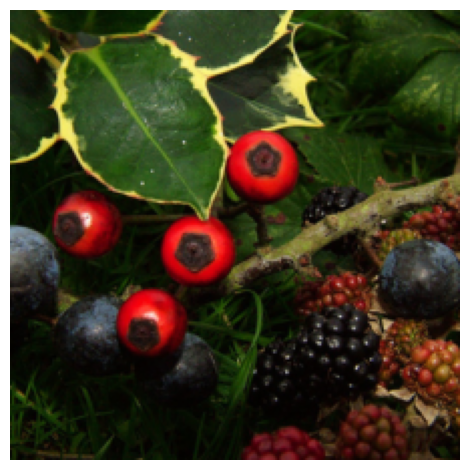

['n12620546', 'hip']


In [48]:
index = 10
imshow(examples[index], mean, std)
print(imagenet_class_json[str(labels[index].item())])

In [49]:
print(examples.shape)
print(labels.shape)
indices = torch.randperm(examples.shape[0])
duplicate = True
while duplicate:
    indices = torch.randperm(examples.shape[0])
    for i in range(examples.shape[0]):
        duplicate = False
        if labels[i] == labels[indices[i]]:
            duplicate = True
            break
print(indices)

torch.Size([12, 3, 224, 224])
torch.Size([12])
tensor([ 9,  3,  7,  8, 11,  0,  1,  2, 10,  5,  4,  6])


In [50]:
malicious_labels = labels.clone()[indices]
malicious_labels = [imagenet_class_json[str(l.item())][1] for l in malicious_labels]
malicious_examples = examples.clone()[indices]
unsafe_perturbations = malicious_examples - examples

In [44]:
corruptions = collections.OrderedDict()
corruptions["Gaussian Noise"] = make_imagenet_c.gaussian_noise
corruptions["Shot Noise"] = make_imagenet_c.shot_noise
corruptions["Impulse Noise"] = make_imagenet_c.impulse_noise
corruptions["Defocus Blur"] = make_imagenet_c.defocus_blur
corruptions["Glass Blur"] = make_imagenet_c.glass_blur
corruptions["Motion Blur"] = make_imagenet_c.motion_blur
corruptions["Zoom Blur"] = make_imagenet_c.zoom_blur
corruptions["Snow"] = make_imagenet_c.snow
corruptions["Frost"] = make_imagenet_c.frost
corruptions["Fog"] = make_imagenet_c.fog
corruptions["Brightness"] = make_imagenet_c.brightness
corruptions["Contrast"] = make_imagenet_c.contrast
corruptions["Elastic"] = make_imagenet_c.elastic_transform
corruptions["Pixelate"] = make_imagenet_c.pixelate
corruptions["JPEG"] = make_imagenet_c.jpeg_compression

corruptions["Speckle Noise"] = make_imagenet_c.speckle_noise
corruptions["Gaussian Blur"] = make_imagenet_c.gaussian_blur
corruptions["Spatter"] = make_imagenet_c.spatter
corruptions["Saturate"] = make_imagenet_c.saturate


corruption_tuple = (
    gaussian_noise,
    shot_noise,
    impulse_noise,
    defocus_blur,
    glass_blur,
    motion_blur,
    zoom_blur,
    snow,
    frost,
    fog,
    brightness,
    contrast,
    elastic_transform,
    pixelate,
    jpeg_compression,
    speckle_noise,
    gaussian_blur,
    spatter,
    saturate,
)


corrname_dict = {
    "gaussian_noise": "Gaussian Noise",
    "shot_noise": "Shot Noise",
    "impulse_noise": "Impulse Noise",
    "defocus_blur": "Defocus Blur",
    "glass_blur": "Glass Blur",
    "motion_blur": "Motion Blur",
    "zoom_blur": "Zoom Blur",
    "snow": "Snow",
    "frost": "Frost",  # frost,
    "fog": "Fog",
    "brightness": "Brightness",
    "contrast": "Contrast",
    "elastic_transform": "Elastic Transform",
    "pixelate": "Pixelate",
    "jpeg_compression": "JPEG Compression",
    "speckle_noise": "Speckle Noise",
    "gaussian_blur": "Gaussian Blur",
    "spatter": "Spatter",
    "saturate": "Saturate",
}

corrmethod_dict = {
    "Gaussian Noise": "gaussian_noise",
    "Shot Noise": "shot_noise",
    "Impulse Noise": "impulse_noise",
    "Defocus Blur": "defocus_blur",
    "Glass Blur": "glass_blur",
    "Motion Blur": "motion_blur",
    "Zoom Blur": "zoom_blur",
    "Snow": "snow",
    "Frost": "frost",  # frost,
    "Fog": "fog",
    "Brightness": "brightness",
    "Contrast": "contrast",
    "Elastic Transform": "elastic_transform",
    "Pixelate": "pixelate",
    "JPEG Compression": "jpeg_compression",
    "Speckle Noise": "speckle_noise",
    "Gaussian Blur": "gaussian_blur",
    "Spatter": "spatter",
    "Saturate": "saturate",
}

corruption_dict = {corr_func.__name__: corr_func for corr_func in corruption_tuple}
num = len(corruption_dict.keys()) - 1
print(num)

common_corruptions_2d_bar = [
    "blue_noise_sample",
    "brownish_noise",
    "caustic_refraction",
    "checkerboard_cutout",
    "cocentric_sine_waves",
    "inverse_sparkles",
    "perlin_noise",
    "plasma_noise",
    "single_frequency_greyscale",
    "sparkles",
]
corruption_bar_names = [
    word.replace("_", " ").title() for word in list(cbar_dict.keys())
]

corrname_bar_dict = {}
for word in list(cbar_dict.keys()):
    corrname_bar_dict[word] = word.replace("_", " ").title()

common_corruptions_2d_bar_severities = {
    "Blue Noise Sample": [0.8, 1.6, 2.4, 3.2, 4.0, 4.8, 5.6, 6.4, 7.2, 8.0],
    "Blue Noise": [0.7, 1.4, 2.1, 2.8, 3.5, 4.2, 4.9, 5.6, 6.3, 7.0],
    "Brownish Noise": [1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0],
    "Caustic Refraction": [2.35, 3.2, 4.05, 4.9, 5.75, 6.6, 7.45, 8.3, 9.15, 10.0],
    "Checkerboard Cutout": [1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0],
    "Lines": [0.8, 1.6, 2.4, 3.2, 4.0, 4.8, 5.6, 6.4, 7.2, 8.0],
    "Cocentric Sine Waves": [1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0],
    "Inverse Sparkles": [1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0],
    "Perlin Noise": [4.6, 5.2, 5.8, 6.4, 7.0, 7.6, 8.2, 8.8, 9.4, 10.0],
    "Plasma Noise": [3.25, 4.0, 4.75, 5.5, 6.25, 7.0, 7.75, 8.5, 9.25, 10.0],
    "Voronoi Noise": [3.25, 4.0, 4.75, 5.5, 6.25, 7.0, 7.75, 8.5, 9.25, 10.0],
    "Caustic Noise": [3.25, 4.0, 4.75, 5.5, 6.25, 7.0, 7.75, 8.5, 9.25, 10.0],
    "Single Frequency Greyscale": [0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, 4.5, 5.0],
    "Sparkles": [1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0],
    "Scatter": [0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, 4.5, 5.0],
    "Chromatic Abberation": [1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0],
    "Transverse Chromatic Abberation": [1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0],
    "Pinch And Twirl" : [4.15, 4.8, 5.45, 6.1, 6.75, 7.4, 8.05, 8.7, 9.35, 10.0],
    "Fish Eye": [0.4, 0.8, 1.2, 1.6, 2.0, 2.4, 2.8, 3.2, 3.6, 4.0],
    "Water Drop": [5.5, 6.0, 6.5, 7.0, 7.5, 8.0, 8.5, 9.0, 9.5, 10.0],
    "Ripple": [3.25, 4.0, 4.75, 5.5, 6.25, 7.0, 7.75, 8.5, 9.25, 10.0],
    "Bleach Bypass" : [1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0],
    "Technicolor" : [1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0],
    "Pseudocolor" : [1.9, 2.8, 3.7, 4.6, 5.5, 6.4, 7.3, 8.2, 9.1, 10.0],
    "Color Balance": [1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0],
    "Quadrilateral No Bars": [1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0],
    "Perspective No Bars": [1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0],
    "Hue Shift": [1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0],
    "Circular Motion Blur": [2.35, 3.2, 4.05, 4.9, 5.75, 6.6, 7.45, 8.3, 9.15, 10.0],
    "Color Dither" :[3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 11.0, 12.0],
    "Brownish Noise": [1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0],
}


def corruption_group(corruption_name):
    if corruption_name in [
        "Gaussian Blur",
        "Defocus Blur",
        "Glass Blur",
        "Motion Blur",
        "Zoom Blur",
        "Cocentric Sine Waves",
        "Caustic Refraction",
    ]:
        return "Blur"
    elif corruption_name in [
        "Shot Noise",
        "Impulse Noise",
        "Gaussian Noise",
        "Speckle Noise",
        "Blue Noise Sample",
        "Brownish Noise",
        "Perlin Noise",
        "Plasma Noise",
    ]:
        return "Noise"
    elif corruption_name in ["Frost", "Snow", "Fog"]:
        return "Weather"
    elif corruption_name in [
        "Pixelate",
        "JPEG Compression",
    ]:
        return "Compression"
    elif corruption_name in [
        "Brightness",
        "Contrast",
        "Elastic Transform",
        "Saturate",
        "Single Frequency Greyscale",
    ]:
        return "Digital"
    elif corruption_name in [
        "Spatter",
        "Checkerboard Cutout",
        "Sparkles",
        "Inverse Sparkles",
    ]:
        return "Occlusion"
    elif corruption_name == "Unsafe":
        return "Unsafe"
    else:
        raise ValueError("Corruption name not recognized")

18


In [12]:
def normalize_batch(x, val, ord=2):
    if ord not in [2, float("inf")]:
        raise ValueError("Only L2 and Linf norms are supported")
    if val is None:
        raise ValueError("Provide a float value for val argument")
    if x is None:
        raise ValueError("Provide a batch to normalize")

    x_flattened = x.view(x.shape[0], -1)  # Flatten each vector to [B, C*H*W]
    x_norms = torch.linalg.norm(x_flattened, dim=1, ord=ord)  # Shape: [B, 1]
    # Avoid division by zero by clamping small norms to a minimum value
    x_norms = torch.clamp(x_norms, min=1e-8)
    x_norms = x_norms.unsqueeze(1)

    # Normalize each vector by its norm and multiply by the desired norm
    x_normalized = (
        x_flattened / x_norms
    )  # torch.div(x_flattened, x_norms) # Normalize to unit norm
    x_normalized *= val  # Scale to the desired norm

    # Reshape the normalized vectors back to the original shape [B, C, H, W]
    x_normalized = x_normalized.view(x.shape)
    return x_normalized

In [13]:
# batch_size = examples.shape[0]
# # malicious_threshold = T.linalg.norm(T.flatten(unsafe_perturbations, start_dim=1), dim=1, ord=float("inf")).min().item()
# malicious_threshold = 3.0
# print("Normalization value for Linf norm for unsafe perturbations")
# print(malicious_threshold)

# unsafe_perturbations = normalize_batch(
#     unsafe_perturbations, malicious_threshold, ord=float("inf")
# )
# malicious_examples = examples + unsafe_perturbations


Normalization value for Linf norm for unsafe perturbations
3.0


In [14]:
xmin = examples.min().item() #~ -2.1179
xmax = examples.max().item() #~ 2.6400

In [16]:
corruption_dict.keys()

dict_keys(['gaussian_noise', 'shot_noise', 'impulse_noise', 'defocus_blur', 'glass_blur', 'motion_blur', 'zoom_blur', 'snow', 'frost', 'fog', 'brightness', 'contrast', 'elastic_transform', 'pixelate', 'jpeg_compression', 'speckle_noise', 'gaussian_blur', 'spatter', 'saturate'])

In [17]:
cbar_dict.keys()

dict_keys(['color_balance', 'quadrilateral_no_bars', 'perspective_no_bars', 'single_frequency_greyscale', 'cocentric_sine_waves', 'plasma_noise', 'voronoi_noise', 'caustic_noise', 'perlin_noise', 'blue_noise', 'brownish_noise', 'scatter', 'chromatic_abberation', 'transverse_chromatic_abberation', 'circular_motion_blur', 'bleach_bypass', 'technicolor', 'pseudocolor', 'hue_shift', 'color_dither', 'checkerboard_cutout', 'sparkles', 'inverse_sparkles', 'lines', 'blue_noise_sample', 'pinch_and_twirl', 'caustic_refraction', 'fish_eye', 'water_drop', 'ripple'])

0
Unsafe


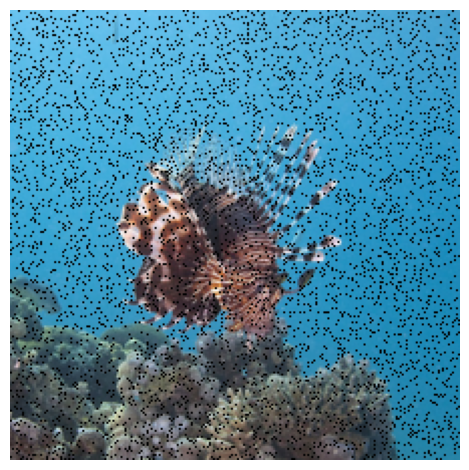

gaussian_noise


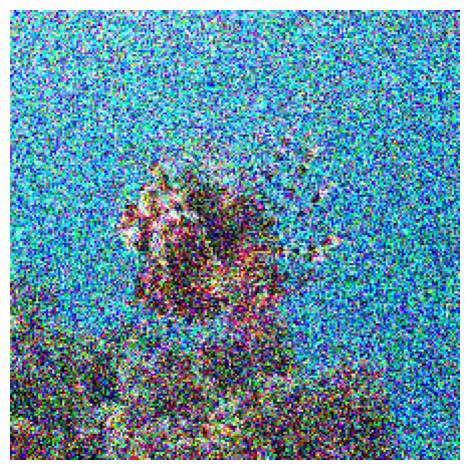

shot_noise


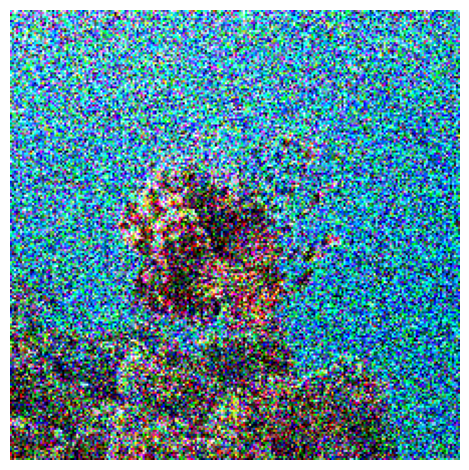

impulse_noise


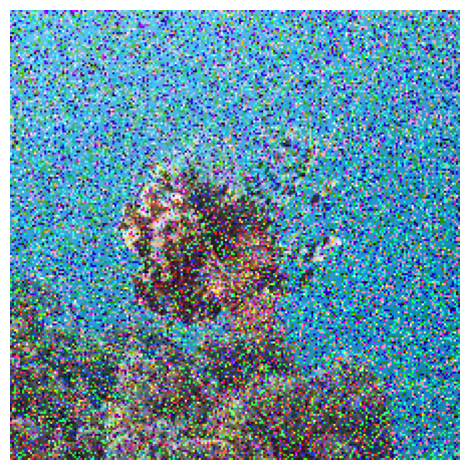

defocus_blur


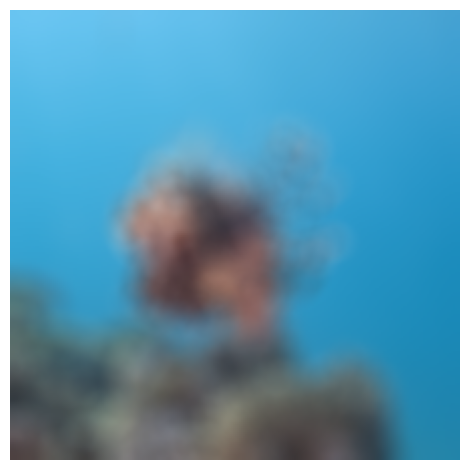

glass_blur


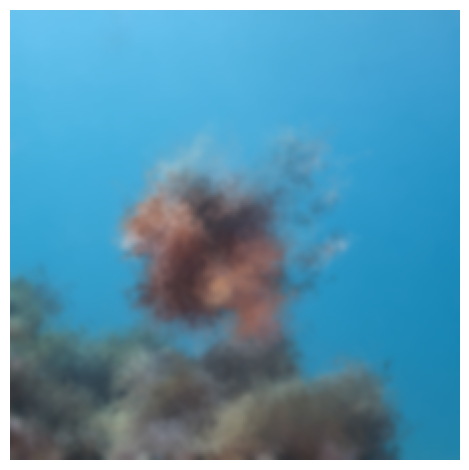

motion_blur


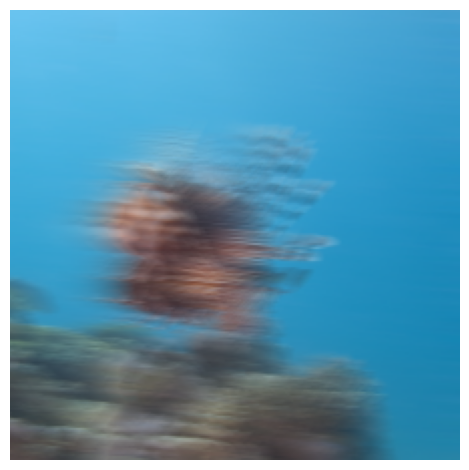

zoom_blur


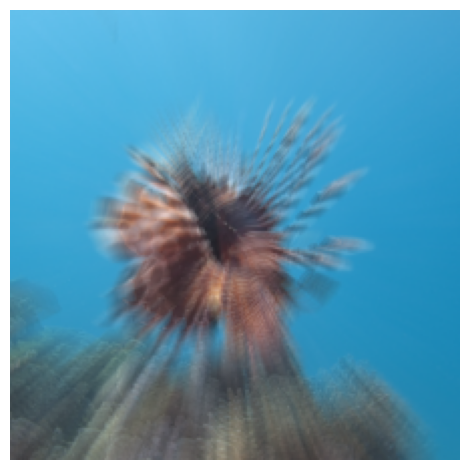

snow


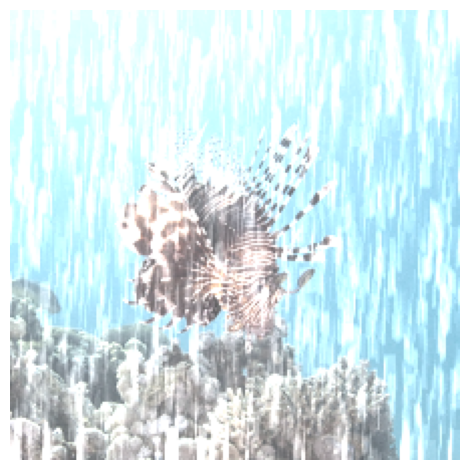

frost


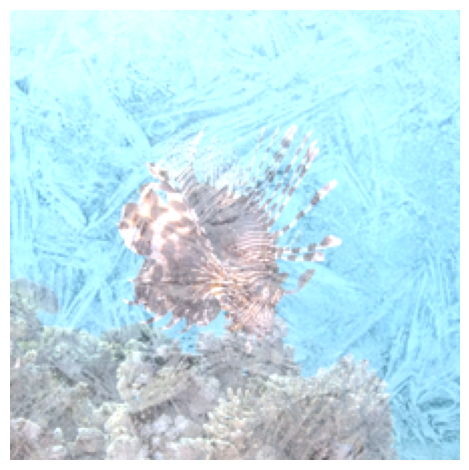

fog


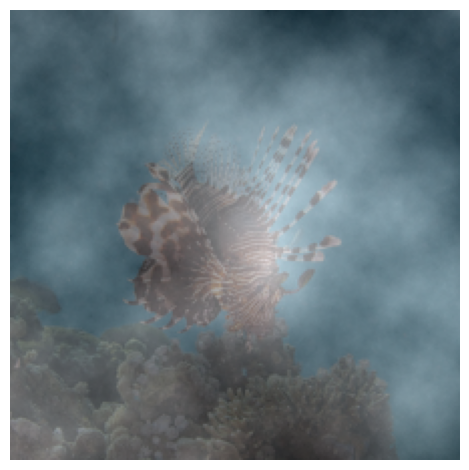

brightness


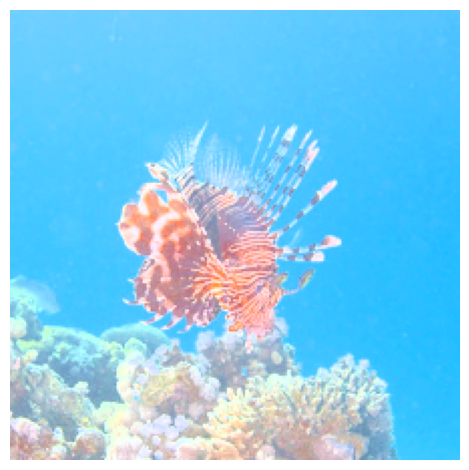

contrast


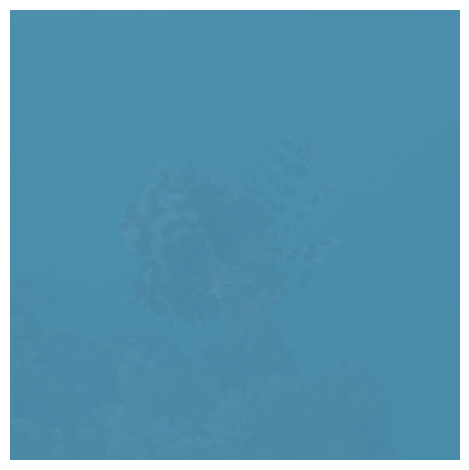

elastic_transform


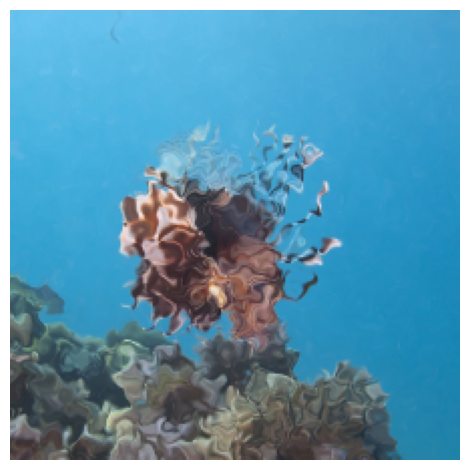

pixelate


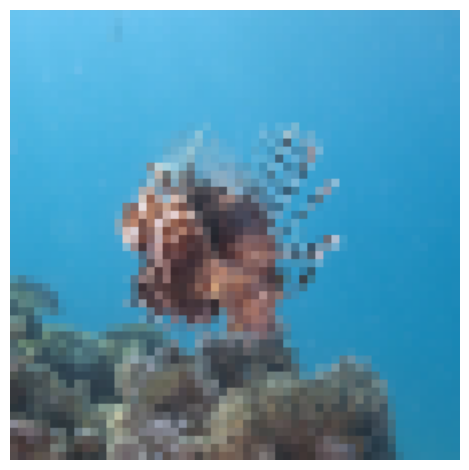

jpeg_compression


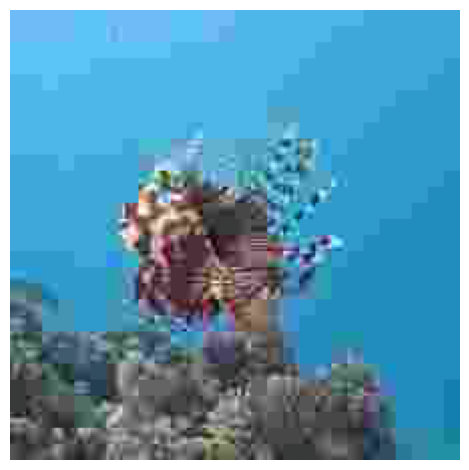

speckle_noise


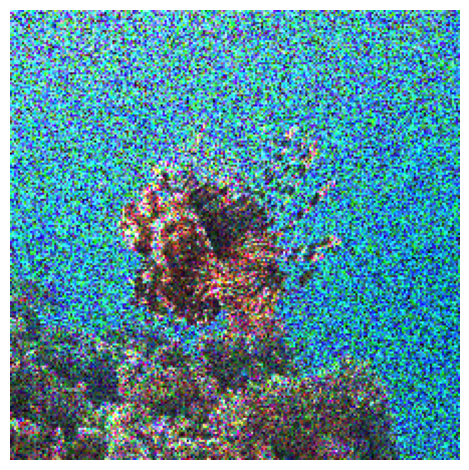

gaussian_blur


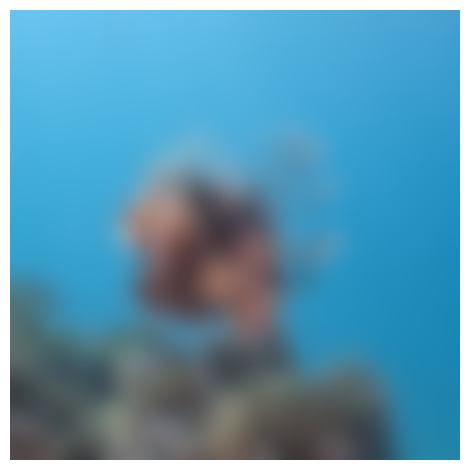

spatter


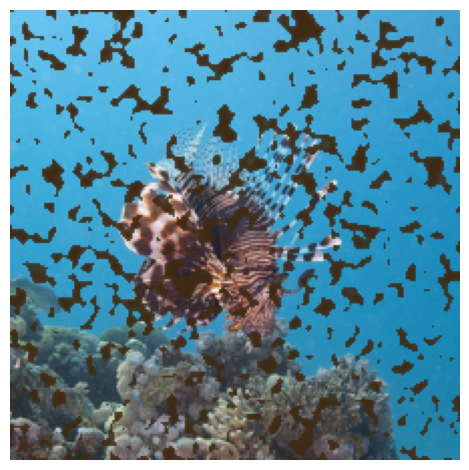

saturate


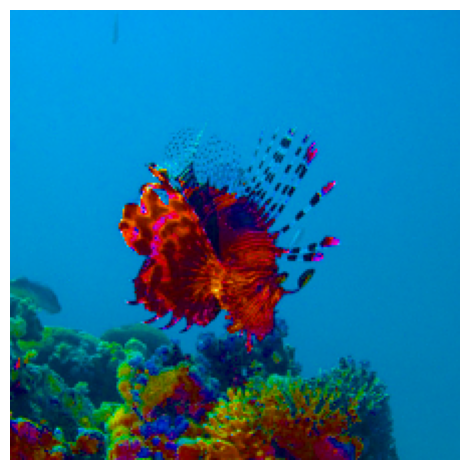

color_balance


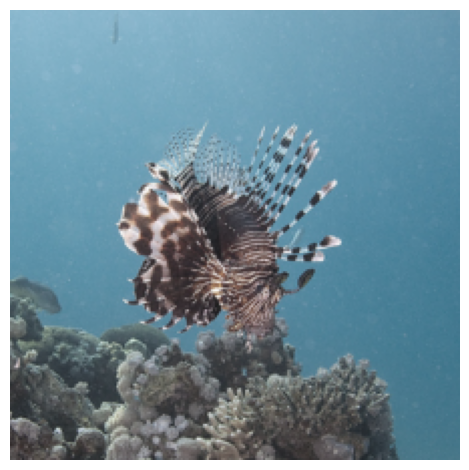

quadrilateral_no_bars


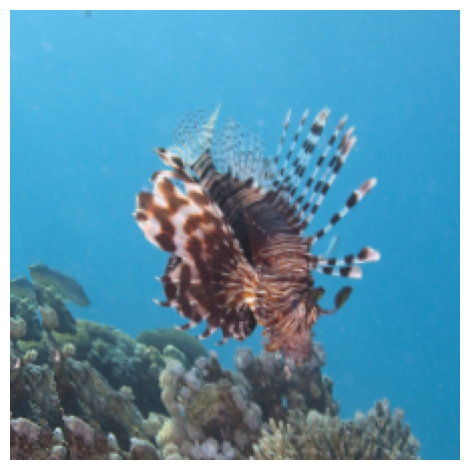

perspective_no_bars


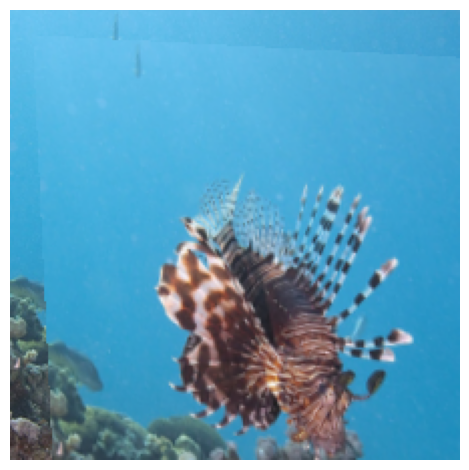

single_frequency_greyscale


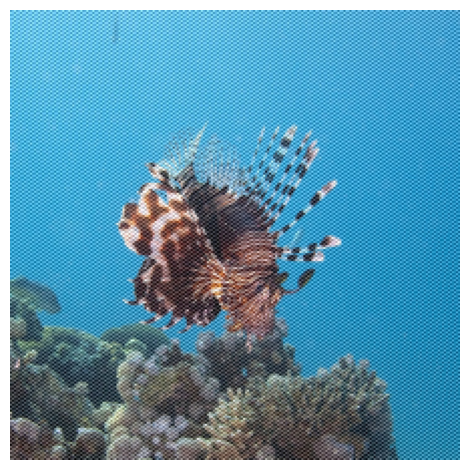

cocentric_sine_waves


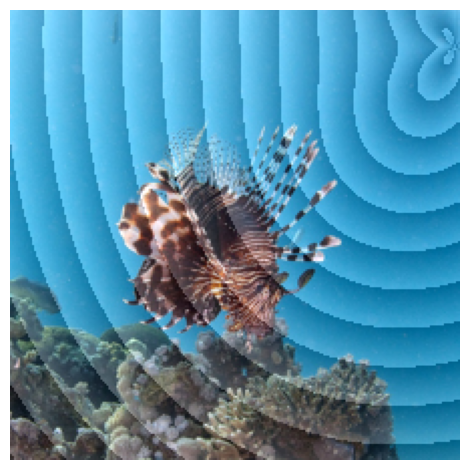

plasma_noise


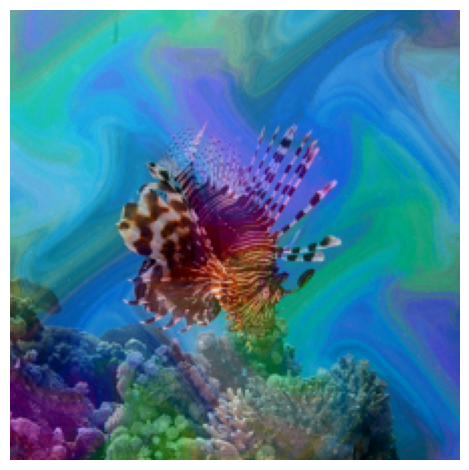

voronoi_noise


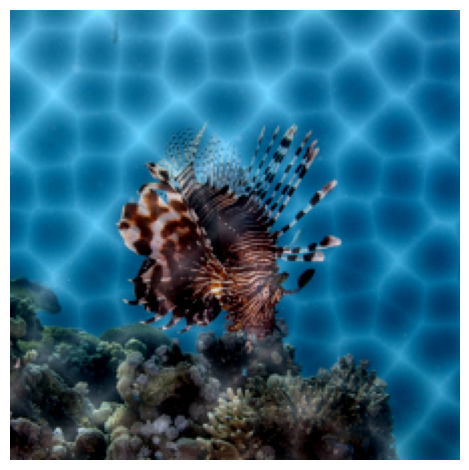

caustic_noise


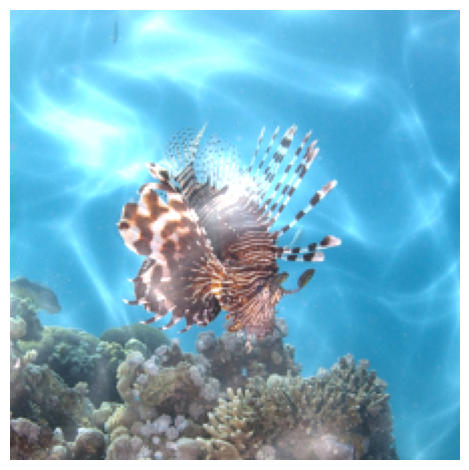

perlin_noise


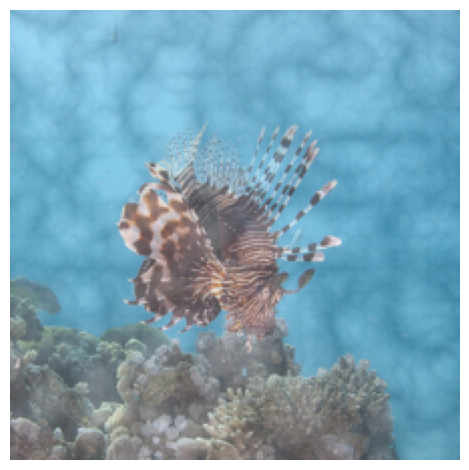

blue_noise


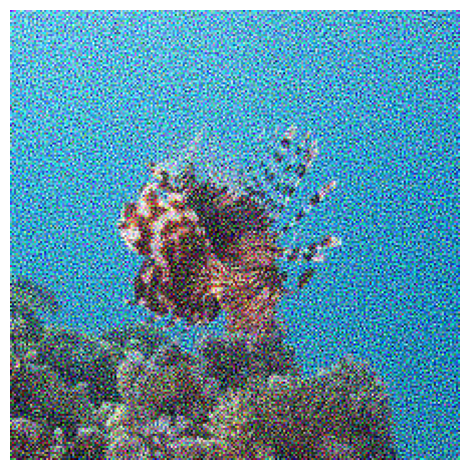

brownish_noise


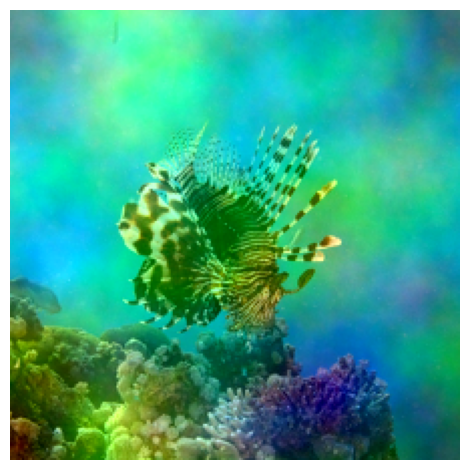

scatter


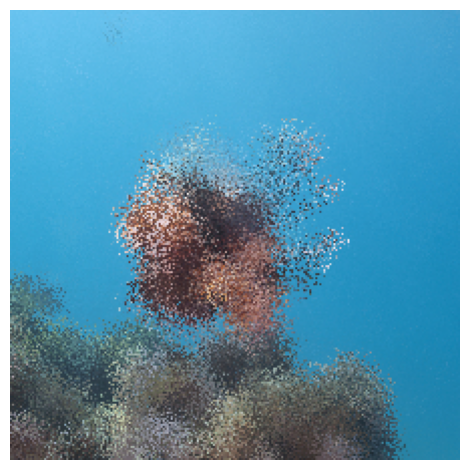

chromatic_abberation


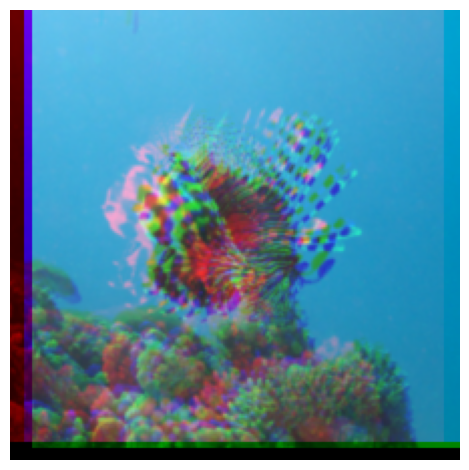

transverse_chromatic_abberation


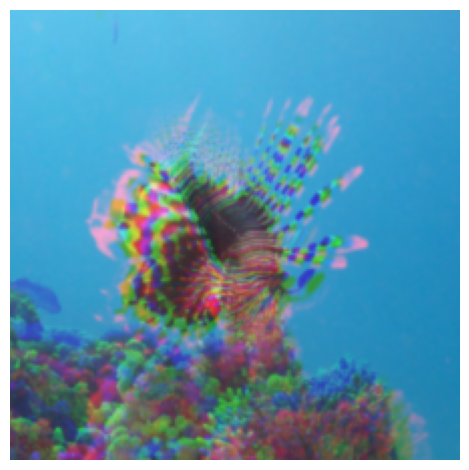

circular_motion_blur


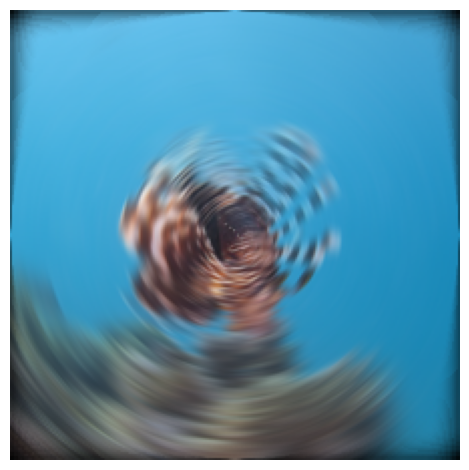

bleach_bypass


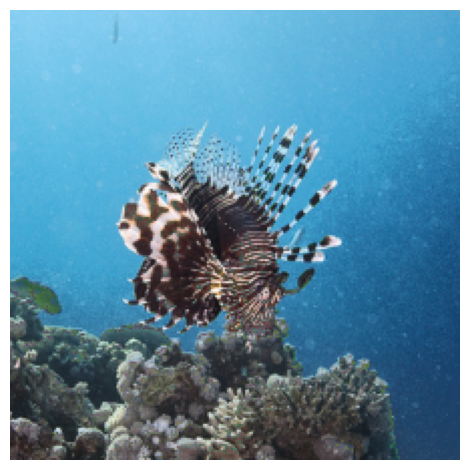

technicolor


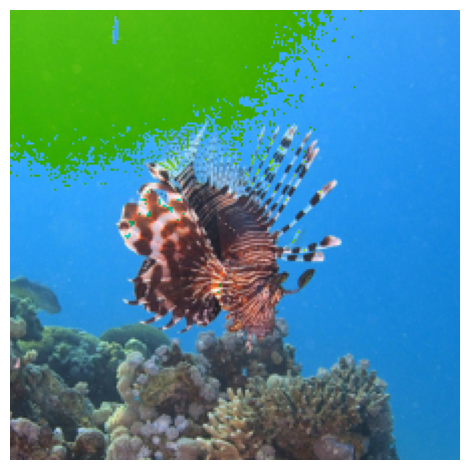

pseudocolor


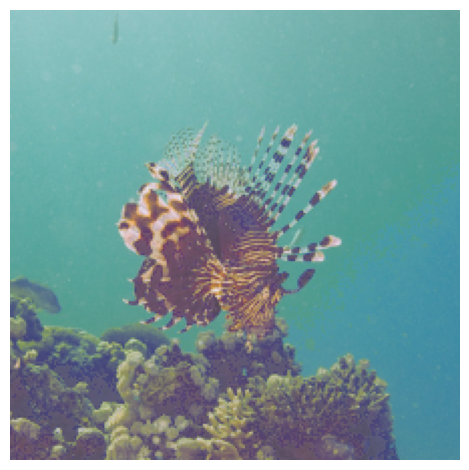

hue_shift


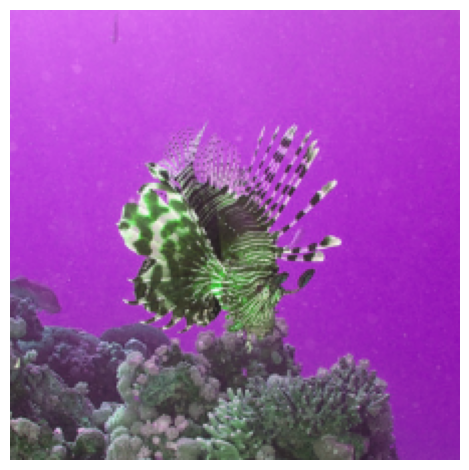

color_dither


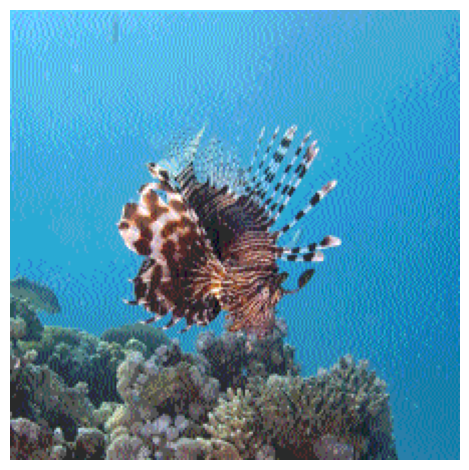

checkerboard_cutout


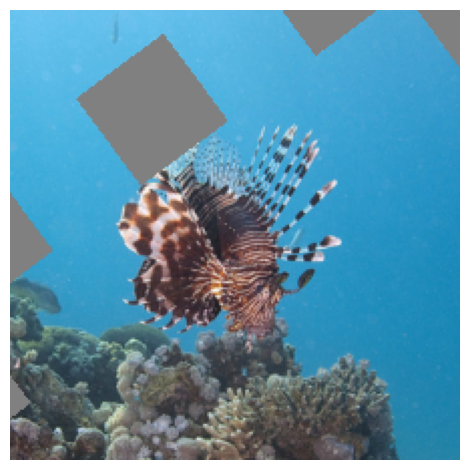

sparkles


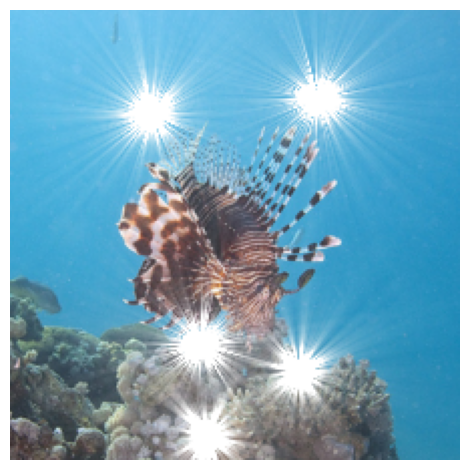

inverse_sparkles


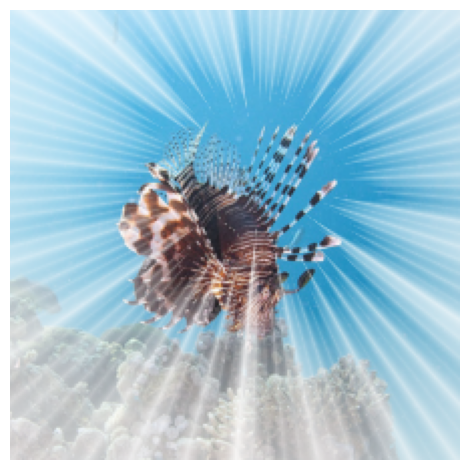

lines


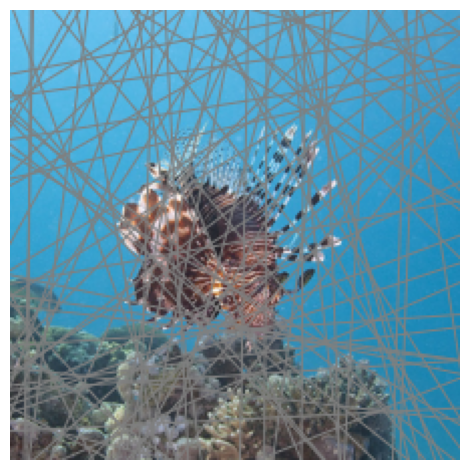

blue_noise_sample


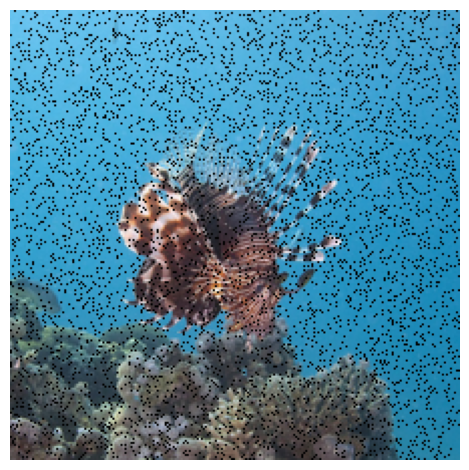

pinch_and_twirl


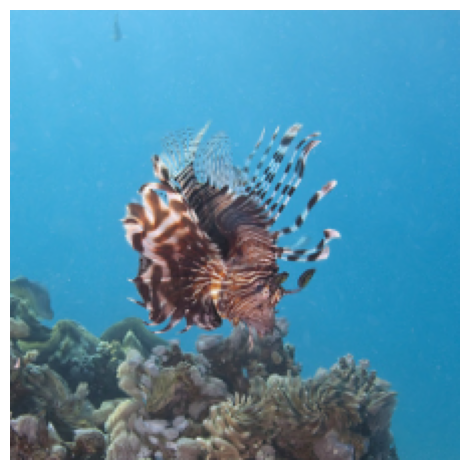

caustic_refraction


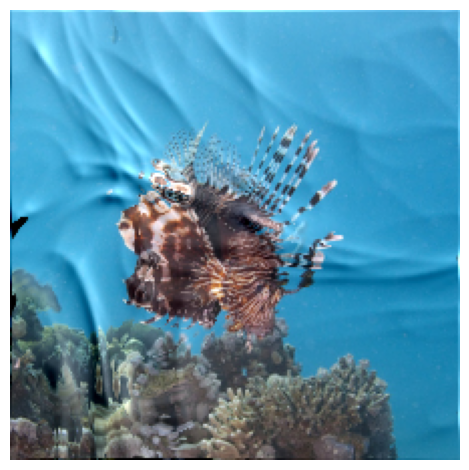

fish_eye


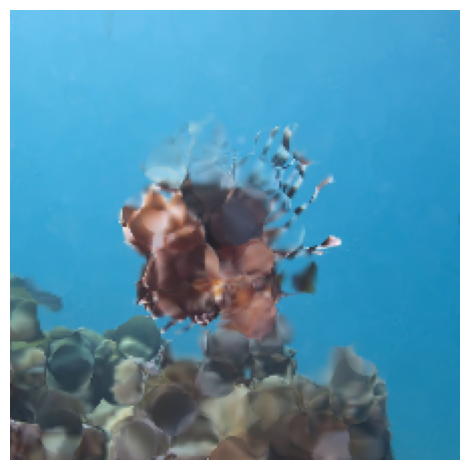

water_drop


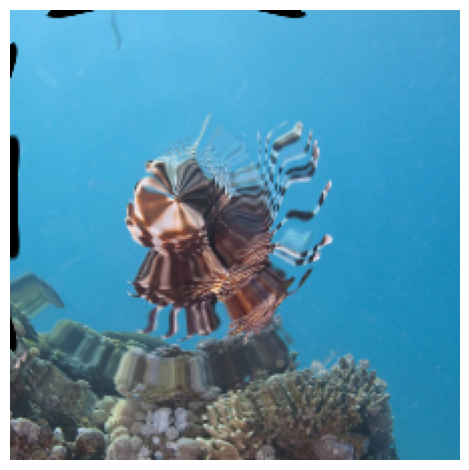

ripple


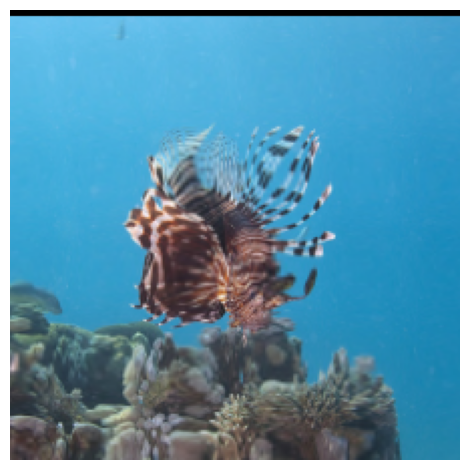

In [51]:
corrupted_examples = {}
severity = 5

for corruption_name in corruption_dict.keys():
    corrupted_examples[corruption_name] = examples.clone().detach()

for corruption_name in cbar_dict.keys():
    corrupted_examples[corruption_name] = examples.clone().detach()


for _index in range(examples.shape[0]):
    if _index % 100 == 0:
        print(_index)
    # denormalize, permute and convert image to numpy array'
    img_T = examples[_index].clone()
    for t, m, s in zip(img_T, mean, std):
        t.mul_(s).add_(m)  # Apply reverse normalization: image * std + mean
    img_T = torch.permute(img_T, (1, 2, 0))
    img = (img_T * 255).byte().numpy()

    for corruption_name in corrupted_examples.keys():
        if _index == 0:
            print(corruption_name)
        if corruption_name in corruption_dict.keys():
            img_corrupted = corrupt(
                img, corruption_name=corruption_name, severity=severity
            )
        elif corruption_name in cbar_dict.keys():
            # if corruption_name not in common_corruptions_2d_bar:
            #     continue 
            severity_val = common_corruptions_2d_bar_severities[
                corrname_bar_dict[corruption_name]
            ][severity-1]
            corruption_transform = corruption_cbar(
                corruption_name, severity=severity_val, dataset_type="imagenet"
            )
            img_corrupted = corruption_transform(img)

        # convert numpy image back to normalized tensor
        img_tensor = torch.from_numpy(img_corrupted).permute(2, 0, 1).float() / 255.0
        img_tensor = (img_tensor - torch.tensor(mean)[:, None, None]) / torch.tensor(
            std
        )[:, None, None]
        corrupted_examples[corruption_name][_index] = img_tensor
        if _index == 0:
            imshow(img_tensor, mean, std)

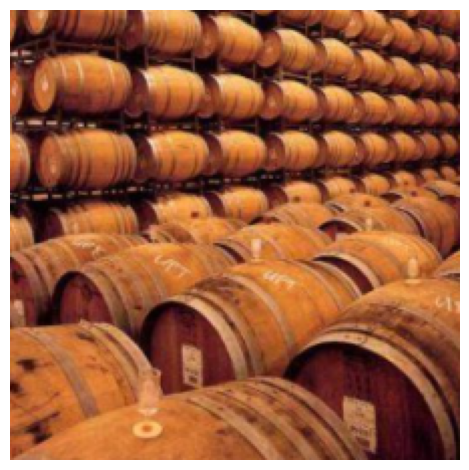

In [69]:
corrupted_examples["Unsafe"] = malicious_examples.clone().detach()

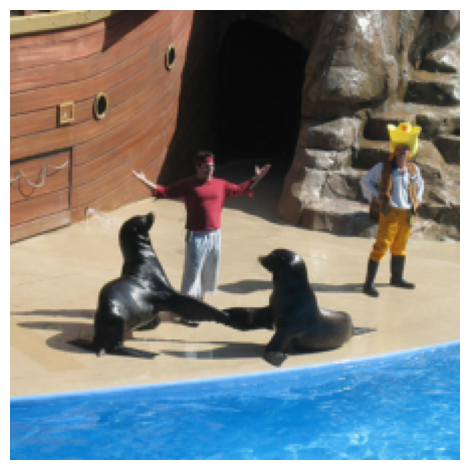

In [70]:
imshow(corrupted_examples["Unsafe"][10], mean, std)

In [68]:
word_labels

['lionfish',
 'limousine',
 'spotted_salamander',
 'polecat',
 'sea_lion',
 'freight_car',
 'ant',
 'Bouvier_des_Flandres',
 'patas',
 'barrel',
 'hip',
 'zebra']

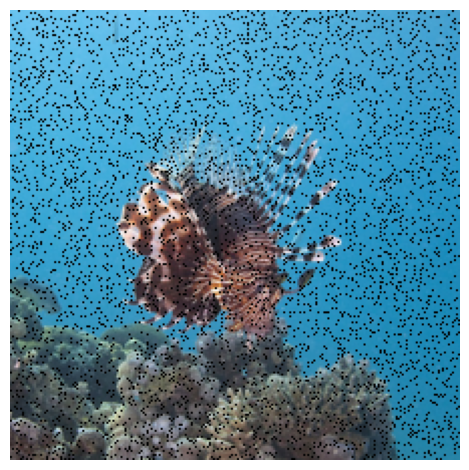

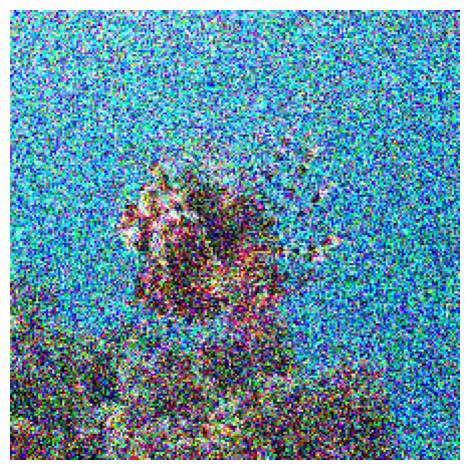

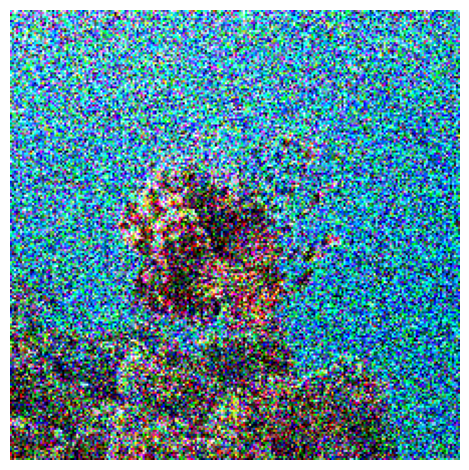

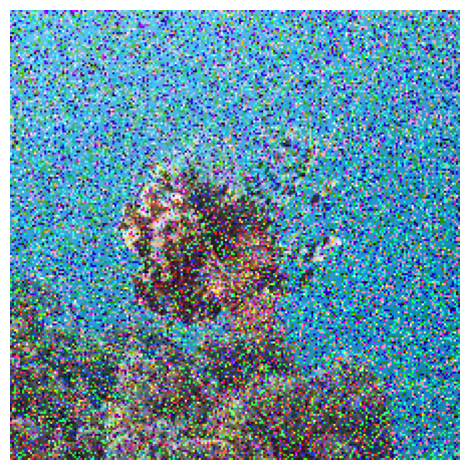

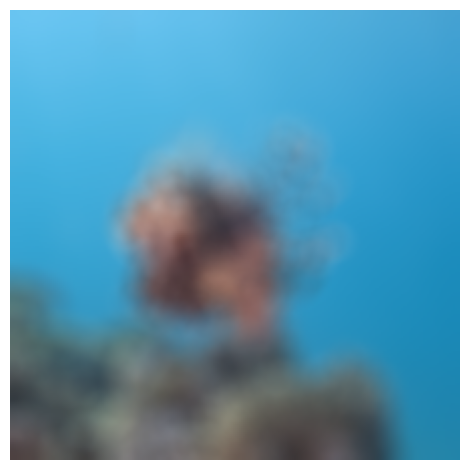

...

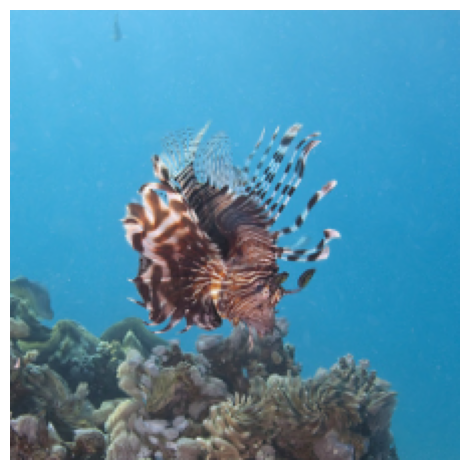

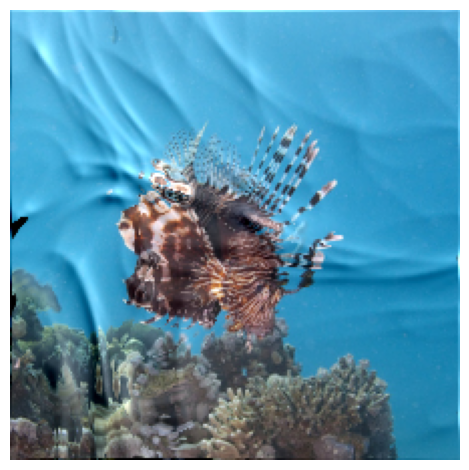

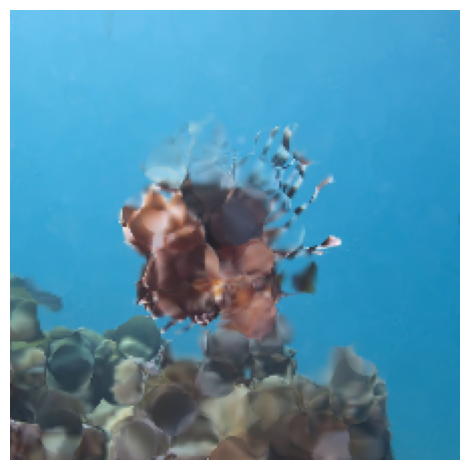

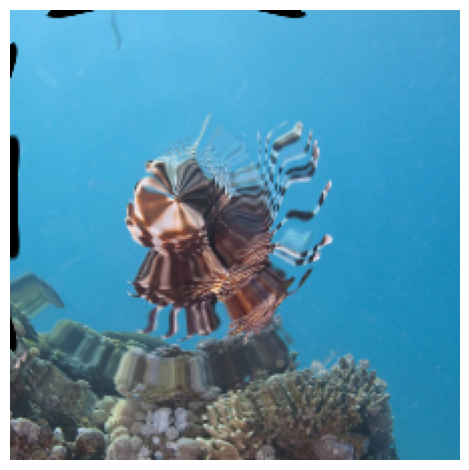

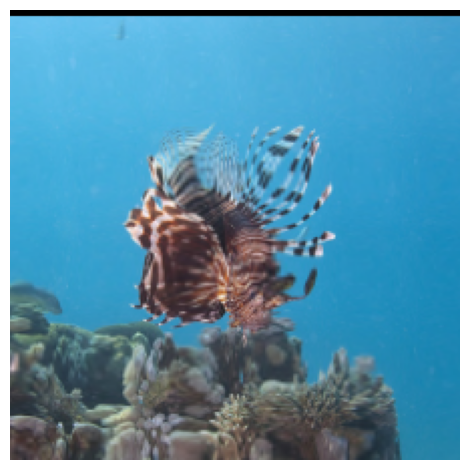

In [68]:
index = 0
for corruption_name in corrupted_examples.keys():
    img_tensor = corrupted_examples[corruption_name][index]
    imshow(img_tensor, mean, std)

In [71]:
# DS = {}
# PD = {}
# PD_S = {}
# PD_W = {}
# L2 = {}
# Linf = {}

for corruption_name in corrupted_examples.keys():
    if corruption_name != "Unsafe":
        continue 

    print(corruption_name)
    perturbed_examples = corrupted_examples[corruption_name]

    DS[corruption_name] = ds_model(
            examples.cuda(), perturbed_examples.cuda()
        ).cpu().numpy()
    
    perturbations_flat = torch.flatten(perturbed_examples - examples, start_dim=1)

    L2[corruption_name] = torch.linalg.norm(perturbations_flat, dim=1, ord=2).numpy()

    Linf[corruption_name] = torch.linalg.norm(
            perturbations_flat, dim=1, ord=float("inf")
    ).numpy()

    PD[corruption_name] = threat_model.evaluate(
            examples,
            labels,
            perturbed_examples,
            weighted=False,
            segmented=False,
    )

    PD_W[corruption_name] = threat_model.evaluate(
            examples,
            labels,
            perturbed_examples,
            weighted=True,
            segmented=False,
    )

    PD_S[corruption_name] = threat_model.evaluate(
            examples,
            labels,
            perturbed_examples,
            weighted=False,
            segmented=True,
    )

Unsafe


In [58]:
xmax-xmin

4.757904052734375

In [64]:
PD['Unsafe']

tensor([0.4355, 2.0801, 1.9873, 2.3887, 2.2129, 2.3457, 2.3770, 1.7100, 3.0078,
        2.1016, 2.3555, 2.2871])

In [72]:
index = 0
print(word_labels[index])

scale_lp = xmax - xmin

print("\n\n Linf")
for corruption_name in corrupted_examples.keys():
    val = Linf[corruption_name][index] / scale_lp
    print("\n")
    print(f"For corruption name {corruption_name}, \t Linf :{val:.2f}")

print("\n\n L2")
for corruption_name in corrupted_examples.keys():
    val = L2[corruption_name][index] / (scale_lp * math.sqrt(3 * 224 * 224))
    print("\n")
    print(f"For corruption name {corruption_name}, \t L2 : {val:.2f}")

print("\n\n PD")
for corruption_name in corrupted_examples.keys():
    val = PD[corruption_name][index]
    print("\n")
    print(f"For corruption name {corruption_name}, \t PD {val:.2f}")

print("\n\n PD-W")
for corruption_name in corrupted_examples.keys():
    val = PD_W[corruption_name][index]
    print("\n")
    print(f"For corruption name {corruption_name}, \t PD-W {val:.2f}")

print("\n\n PD-S")
for corruption_name in corrupted_examples.keys():
    val = PD_S[corruption_name][index]
    print("\n")
    print(f"For corruption name {corruption_name}, \t PD-S {val:.2f}")

print("\n\n DS")
for corruption_name in corrupted_examples.keys():
    val = DS[corruption_name][index]
    print("\n")
    print(f"For corruption name {corruption_name}, \t DS {val:.2f}")

lionfish


 Linf


For corruption name Unsafe, 	 Linf :0.89


For corruption name gaussian_noise, 	 Linf :0.88


For corruption name shot_noise, 	 Linf :0.89


For corruption name impulse_noise, 	 Linf :0.90


For corruption name defocus_blur, 	 Linf :0.64


For corruption name glass_blur, 	 Linf :0.59


For corruption name motion_blur, 	 Linf :0.66


For corruption name zoom_blur, 	 Linf :0.51


For corruption name snow, 	 Linf :0.82


For corruption name frost, 	 Linf :0.58


For corruption name fog, 	 Linf :0.61


For corruption name brightness, 	 Linf :0.47


For corruption name contrast, 	 Linf :0.60


For corruption name elastic_transform, 	 Linf :0.69


For corruption name pixelate, 	 Linf :0.54


For corruption name jpeg_compression, 	 Linf :0.51


For corruption name speckle_noise, 	 Linf :0.91


For corruption name gaussian_blur, 	 Linf :0.63


For corruption name spatter, 	 Linf :0.81


For corruption name saturate, 	 Linf :0.87


For corruption name color_balance, 	 Linf :0

In [57]:
examples.shape[0]

12

True label is lionfish


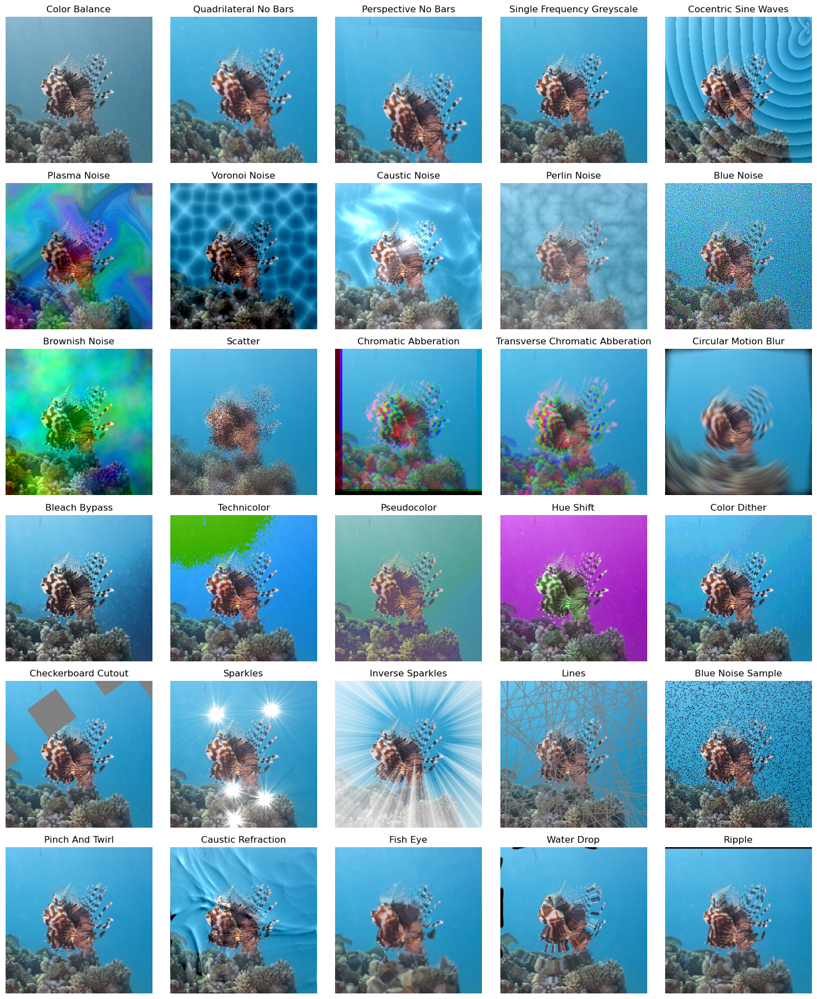

In [78]:
#index = torch.randint(0, examples.shape[0], (1,)).item()
index = 0


print("True label is " + word_labels[index])

fig, axes = plt.subplots(6, 5, figsize=(15, 18))
axes = axes.flatten()  # Flatten the axes for easy indexing

# img_T = examples[index].clone()
# normalize = True
# if normalize:
#     for t, m, s in zip(img_T, mean, std):
#         t.mul_(s).add_(m)  # Apply reverse normalization: image * std + mean

# img_T = torch.permute(img_T, (1, 2, 0))
# img = (img_T * 255).byte().numpy()
# axes[0].imshow(img)
# axes[0].axis("off")
# axes[0].set_title("Original", fontsize=12)  # Turn off axis

# img_T = malicious_examples[index].clone()
# normalize = True
# if normalize:
#     for t, m, s in zip(img_T, mean, std):
#         t.mul_(s).add_(m)  # Apply reverse normalization: image * std + mean

# img_T = torch.permute(img_T, (1, 2, 0))
# img = (img_T * 255).byte().numpy()
# axes[1].imshow(img)
# axes[1].axis("off")
# axes[1].set_title("Unsafe", fontsize=12)  # Turn off axis


for i, corruption_name in enumerate(cbar_dict.keys()):
    img_T = corrupted_examples[corruption_name][index].clone()
    if normalize:
        for t, m, s in zip(img_T, mean, std):
            t.mul_(s).add_(m)  # Apply reverse normalization: image * std + mean
    img_T = torch.permute(img_T, (1, 2, 0))
    img_corrupted = (img_T * 255).byte().numpy()

    axes[i].imshow(img_corrupted)
    axes[i].axis("off")
    axes[i].set_title(corrname_bar_dict[corruption_name], fontsize=12)  # Turn off axis

fig.subplots_adjust(hspace=0.05, wspace=0.01)
plt.tight_layout()
plt.savefig("Final_lionfish_cbar.pdf")
# plt.show()



True label is lionfish


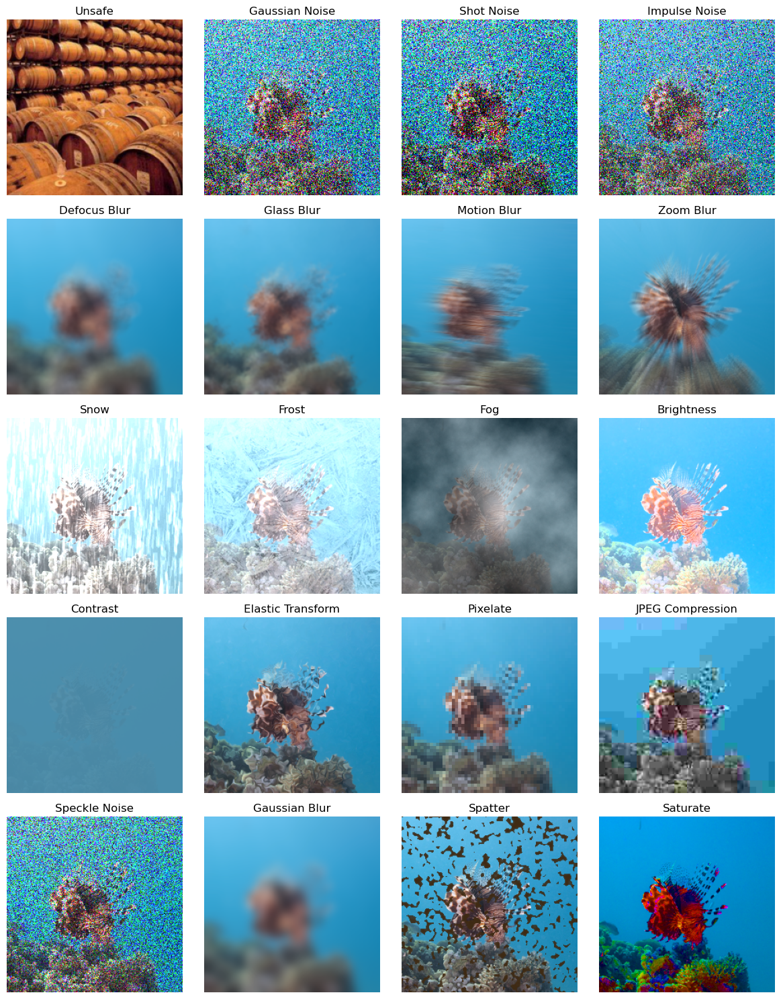

In [77]:
#index = torch.randint(0, examples.shape[0], (1,)).item()
index = 0
print("True label is " + word_labels[index])

fig, axes = plt.subplots(5, 4, figsize=(12, 15))
axes = axes.flatten()  # Flatten the axes for easy indexing
 
# img_T = examples[index].clone()
# normalize = True
# if normalize:
#     for t, m, s in zip(img_T, mean, std):
#         t.mul_(s).add_(m)  # Apply reverse normalization: image * std + mean

# img_T = torch.permute(img_T, (1, 2, 0))
# img = (img_T * 255).byte().numpy()
# axes[0].imshow(img)
# axes[0].axis("off")
# axes[0].set_title("Original", fontsize=12)  # Turn off axis

img_T = malicious_examples[index].clone()
normalize = True
if normalize:
    for t, m, s in zip(img_T, mean, std):
        t.mul_(s).add_(m)  # Apply reverse normalization: image * std + mean

img_T = torch.permute(img_T, (1, 2, 0))
img = (img_T * 255).byte().numpy()
axes[0].imshow(img)
axes[0].axis("off")
axes[0].set_title("Unsafe", fontsize=12)  # Turn off axis


for i, corruption_name in enumerate(corruption_dict.keys()):
    img_T = corrupted_examples[corruption_name][index].clone()
    if normalize:
        for t, m, s in zip(img_T, mean, std):
            t.mul_(s).add_(m)  # Apply reverse normalization: image * std + mean
    img_T = torch.permute(img_T, (1, 2, 0))
    img_corrupted = (img_T * 255).byte().numpy()

    axes[i+1].imshow(img_corrupted)
    axes[i+1].axis("off")
    axes[i+1].set_title(corrname_dict[corruption_name], fontsize=12)  # Turn off axis

fig.subplots_adjust(hspace=0.05, wspace=0.01)
plt.tight_layout()
# if file_name is not None:
plt.savefig("Final_lionfish_c.pdf")
plt.show()

# print(img_corrupted.shape) # outputs (224, 224, 3)
# print(np.max(img_corrupted)) # outputs 255
# print(np.min(img_corrupted)) # outputs 0
# plt.imshow(img_corrupted)